# **Web Traffic Time Series Forecasting**
## **Initial data assessment and visualization**

This notebook focuses on the first step in processing time series data.
It includes procedures for data preprocessing, initial assessment and visualization of key characteristics and statistics.\
Moreover, for the time series formed by the median values of visits to all Wikipedia pages, 
several regression models have been built and studied (see sections [4](#h4) and [5](#h5)).

Data taken from this <a href="https://www.kaggle.com/c/web-traffic-time-series-forecasting">
Kaggle competition </a>.

The structure of this notebook is as follows:

- **[1. Data loading and preprocessing](#h1)**
    - [1.1 Plot 5 random series](#h1.1)
- **[2. Explore some general statistics](#h2)**
    - [2.1 Mean, median, total views](#h2.1)
    - [2.2 Grouping](#h2.2)
- **[3. Analysis of Wiki trends and lags](#h3)**
- **[4. Building some linear models for median data](#h4)**
    - [4.1 Exploring seasonality ](#h4.1)        
    - [4.2 Using fourier series for regression ](#h4.2)
    - [4.3 Exploring values of different lags](#h4.3)
    - [4.4 Exploring performance of several linear models](#h4.4)
    - [4.5 Some feature engineering](#h4.5)
- **[5. Two-stage hybrid model](#h5)**

In [1]:
import os
import warnings
from pathlib import Path

import datetime

import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd
import seaborn as sns
from IPython.display import display
from pandas.api.types import CategoricalDtype

pd.options.display.max_rows = 10
pd.options.display.max_colwidth = 100
pd.options.display.max_columns = 600

from tqdm import tqdm

from statsmodels.graphics.tsaplots import pacf, plot_pacf

from sklearn.linear_model import LinearRegression, HuberRegressor, RANSACRegressor
from sklearn.feature_selection import mutual_info_regression
from sklearn.model_selection import KFold, cross_val_score
from sklearn.model_selection import train_test_split

from xgboost import XGBRegressor

RendererRegistry.enable('default')

In [2]:
''' Plot settings'''

plt.style.use("seaborn-whitegrid")
plt.rc("figure", autolayout=True, figsize=(11, 4))
plt.rc(
    "axes",
    labelweight="bold",
    labelsize="large",
    titleweight="bold",
    titlesize=14,
    titlepad=10,
)
plot_params = dict(
    color="0.75",
    style=".-",
    markeredgecolor="0.25",
    markerfacecolor="0.25",
    legend=False,
)
%config InlineBackend.figure_format = 'retina'

# 1. Data loading and preprocessing <a class="anchor" id="h1"></a>

In [3]:
#df_train_1 = pd.read_csv('../train_1.csv')
df_train = pd.read_csv('data/train_2.csv')

In [5]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145063 entries, 0 to 145062
Columns: 804 entries, Page to 2017-09-10
dtypes: float64(803), object(1)
memory usage: 889.8+ MB


In [6]:
df_train.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2017-09-01,2017-09-02,2017-09-03,2017-09-04,2017-09-05,2017-09-06,2017-09-07,2017-09-08,2017-09-09,2017-09-10
0,2NE1_zh.wikipedia.org_all-access_spider,18.0,11.0,5.0,13.0,14.0,9.0,9.0,22.0,26.0,...,19.0,33.0,33.0,18.0,16.0,27.0,29.0,23.0,54.0,38.0
1,2PM_zh.wikipedia.org_all-access_spider,11.0,14.0,15.0,18.0,11.0,13.0,22.0,11.0,10.0,...,32.0,30.0,11.0,19.0,54.0,25.0,26.0,23.0,13.0,81.0
2,3C_zh.wikipedia.org_all-access_spider,1.0,0.0,1.0,1.0,0.0,4.0,0.0,3.0,4.0,...,6.0,6.0,7.0,2.0,4.0,7.0,3.0,4.0,7.0,6.0
3,4minute_zh.wikipedia.org_all-access_spider,35.0,13.0,10.0,94.0,4.0,26.0,14.0,9.0,11.0,...,7.0,19.0,19.0,9.0,6.0,16.0,19.0,30.0,38.0,4.0
4,52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,16.0,16.0,19.0,9.0,20.0,23.0,28.0,14.0,8.0,7.0


In [7]:
# Convert column data to datetime format

df_train.columns = ['Page'] + [x.date() for x in pd.to_datetime(df_train.columns[1:])]

In [8]:
df_train.set_index('Page', inplace=True)

In [9]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 145063 entries, 2NE1_zh.wikipedia.org_all-access_spider to Francisco_el_matemático_(serie_de_televisión_de_2017)_es.wikipedia.org_all-access_spider
Columns: 803 entries, 2015-07-01 to 2017-09-10
dtypes: float64(803)
memory usage: 889.8+ MB


In [10]:
df_train.columns = pd.MultiIndex.from_tuples([(x.year, x.month, x.day, x.weekday()) for x in df_train.columns],names=['year','month','day','weekday'])

In [11]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 145063 entries, 2NE1_zh.wikipedia.org_all-access_spider to Francisco_el_matemático_(serie_de_televisión_de_2017)_es.wikipedia.org_all-access_spider
Columns: 803 entries, (2015, 7, 1, 2) to (2017, 9, 10, 6)
dtypes: float64(803)
memory usage: 889.8+ MB


In [12]:
#df_train.reset_index(inplace=True)
df_train

year                                                2015                    \
month                                                  7                     
day                                                   1     2     3     4    
weekday                                                2     3     4     5   
Page                                                                         
2NE1_zh.wikipedia.org_all-access_spider             18.0  11.0   5.0  13.0   
2PM_zh.wikipedia.org_all-access_spider              11.0  14.0  15.0  18.0   
3C_zh.wikipedia.org_all-access_spider                1.0   0.0   1.0   1.0   
4minute_zh.wikipedia.org_all-access_spider          35.0  13.0  10.0  94.0   
52_Hz_I_Love_You_zh.wikipedia.org_all-access_sp...   NaN   NaN   NaN   NaN   
...                                                  ...   ...   ...   ...   
Underworld_(serie_de_películas)_es.wikipedia.or...   NaN   NaN   NaN   NaN   
Resident_Evil:_Capítulo_Final_es.wikipedia.org_...   NaN   NaN   NaN   NaN   
Enamorándome_de_Ramón_es.wikipedia.org_all-acce...   NaN   NaN   NaN   NaN   
Hasta_el_último_hombre_es.wikipedia.org_all-acc...   NaN   NaN   NaN   NaN   
Francisco_el_matemático_(serie_de_televisión_de...   NaN   NaN   NaN   NaN   

year                                                                        \
month                                                                        
day                                                   5     6     7     8    
weekday                                                6     0     1     2   
Page                                                                         
2NE1_zh.wikipedia.org_all-access_spider             14.0   9.0   9.0  22.0   
2PM_zh.wikipedia.org_all-access_spider              11.0  13.0  22.0  11.0   
3C_zh.wikipedia.org_all-access_spider                0.0   4.0   0.0   3.0   
4minute_zh.wikipedia.org_all-access_spider           4.0  26.0  14.0   9.0   
52_Hz_I_Love_You_zh.wikipedia.org_all-access_sp...   NaN   NaN   NaN   NaN   
...                                                  ...   ...   ...   ...   
Underworld_(serie_de_películas)_es.wikipedia.or...   NaN   NaN   NaN   NaN   
Resident_Evil:_Capítulo_Final_es.wikipedia.org_...   NaN   NaN   NaN   NaN   
Enamorándome_de_Ramón_es.wikipedia.org_all-acce...   NaN   NaN   NaN   NaN   
Hasta_el_último_hombre_es.wikipedia.org_all-acc...   NaN   NaN   NaN   NaN   
Francisco_el_matemático_(serie_de_televisión_de...   NaN   NaN   NaN   NaN   

year                                                            ...  2017  \
month                                                           ...     9   
day                                                   9     10  ...    1    
weekday                                                3     4  ...     4   
Page                                                            ...         
2NE1_zh.wikipedia.org_all-access_spider             26.0  24.0  ...  19.0   
2PM_zh.wikipedia.org_all-access_spider              10.0   4.0  ...  32.0   
3C_zh.wikipedia.org_all-access_spider                4.0   4.0  ...   6.0   
4minute_zh.wikipedia.org_all-access_spider          11.0  16.0  ...   7.0   
52_Hz_I_Love_You_zh.wikipedia.org_all-access_sp...   NaN   NaN  ...  16.0   
...                                                  ...   ...  ...   ...   
Underworld_(serie_de_películas)_es.wikipedia.or...   NaN   NaN  ...   0.0   
Resident_Evil:_Capítulo_Final_es.wikipedia.org_...   NaN   NaN  ...   4.0   
Enamorándome_de_Ramón_es.wikipedia.org_all-acce...   NaN   NaN  ...  11.0   
Hasta_el_último_hombre_es.wikipedia.org_all-acc...   NaN   NaN  ...   4.0   
Francisco_el_matemático_(serie_de_televisión_de...   NaN   NaN  ...   2.0   

year                                                                        \
month                                                                        
day                                                   2     3     4     5    
weekday                            

In [13]:
# Parse the joint page name on page, site, access and agent parts:

page_data = [page.split('_') for page in df_train.index]

df_train.index = pd.MultiIndex.from_tuples([('_'.join(page[:-3]), page[-3], page[-2], page[-1]) for page in page_data],names=['page','site','access','agent'])

In [14]:
# Find the first day the site appeared (first day with views > 0)
df_train['first_day'] = df_train.droplevel(level='weekday',axis=1).notna().idxmax(axis=1) 
df_train['first_day'] = df_train['first_day'].apply(lambda x: datetime.date(*x))
df_train.fillna(0, inplace=True)

In [15]:
df_train

year                                                                                   2015  \
month                                                                                     7   
day                                                                                       1   
weekday                                                                                   2   
page                                               site             access     agent          
2NE1                                               zh.wikipedia.org all-access spider  18.0   
2PM                                                zh.wikipedia.org all-access spider  11.0   
3C                                                 zh.wikipedia.org all-access spider   1.0   
4minute                                            zh.wikipedia.org all-access spider  35.0   
52_Hz_I_Love_You                                   zh.wikipedia.org all-access spider   0.0   
...                                                                                     ...   
Underworld_(serie_de_películas)                    es.wikipedia.org all-access spider   0.0   
Resident_Evil:_Capítulo_Final                      es.wikipedia.org all-access spider   0.0   
Enamorándome_de_Ramón                              es.wikipedia.org all-access spider   0.0   
Hasta_el_último_hombre                             es.wikipedia.org all-access spider   0.0   
Francisco_el_matemático_(serie_de_televisión_de... es.wikipedia.org all-access spider   0.0   

year                                                                                         \
month                                                                                         
day                                                                                       2   
weekday                                                                                   3   
page                                               site             access     agent          
2NE1                                               zh.wikipedia.org all-access spider  11.0   
2PM                                                zh.wikipedia.org all-access spider  14.0   
3C                                                 zh.wikipedia.org all-access spider   0.0   
4minute                                            zh.wikipedia.org all-access spider  13.0   
52_Hz_I_Love_You                                   zh.wikipedia.org all-access spider   0.0   
...                                                                                     ...   
Underworld_(serie_de_películas)                    es.wikipedia.org all-access spider   0.0   
Resident_Evil:_Capítulo_Final                      es.wikipedia.org all-access spider   0.0   
Enamorándome_de_Ramón                              es.wikipedia.org all-access spider   0.0   
Hasta_el_último_hombre                             es.wikipedia.org all-access spider   0.0   
Francisco_el_matemático_(serie_de_televisión_de... es.wikipedia.org all-access spider   0.0   

year                                                                                         \
month                                                                                         
day                                                                                       3   
weekday                                                                                   4   
page                                               site             access     agent          
2NE1                                               zh.wikipedia.org all-access spider   5.0   
2PM                                                zh.wikipedia.org all-access spider  15.0   
3C                                                 zh.wikipedia.org all-access spider   1.0   
4minute                                            zh.wikipedia.org all-access spider  10.0   
52_Hz_I_Love_You                                   zh.wikipedia.org all-access spider   0.0   
...     

In [16]:
# Fill the dates earlier the 'first day' by notna

a = df_train.droplevel(level='weekday',axis=1).iloc[:,:-1]    

df_train.iloc[:,:-1] = a.where(a.apply(lambda x: ~(datetime.date(*x.name) < df_train.first_day)))

In [17]:
df_train.head()

year                                                 2015                    \
month                                                   7                     
day                                                     1     2     3     4   
weekday                                                 2     3     4     5   
page             site             access     agent                            
2NE1             zh.wikipedia.org all-access spider  18.0  11.0   5.0  13.0   
2PM              zh.wikipedia.org all-access spider  11.0  14.0  15.0  18.0   
3C               zh.wikipedia.org all-access spider   1.0   0.0   1.0   1.0   
4minute          zh.wikipedia.org all-access spider  35.0  13.0  10.0  94.0   
52_Hz_I_Love_You zh.wikipedia.org all-access spider   NaN   NaN   NaN   NaN   

year                                                                         \
month                                                                         
day                                                     5     6     7     8   
weekday                                                 6     0     1     2   
page             site             access     agent                            
2NE1             zh.wikipedia.org all-access spider  14.0   9.0   9.0  22.0   
2PM              zh.wikipedia.org all-access spider  11.0  13.0  22.0  11.0   
3C               zh.wikipedia.org all-access spider   0.0   4.0   0.0   3.0   
4minute          zh.wikipedia.org all-access spider   4.0  26.0  14.0   9.0   
52_Hz_I_Love_You zh.wikipedia.org all-access spider   NaN   NaN   NaN   NaN   

year                                                             ...  2017  \
month                                                            ...     9   
day                                                     9    10  ...     2   
weekday                                                 3     4  ...     5   
page             site             access     agent               ...         
2NE1             zh.wikipedia.org all-access spider  26.0  24.0  ...  33.0   
2PM              zh.wikipedia.org all-access spider  10.0   4.0  ...  30.0   
3C               zh.wikipedia.org all-access spider   4.0   4.0  ...   6.0   
4minute          zh.wikipedia.org all-access spider  11.0  16.0  ...  19.0   
52_Hz_I_Love_You zh.wikipedia.org all-access spider   NaN   NaN  ...  16.0   

year                                                                         \
month                                                                         
day                                                     3     4     5     6   
weekday                                                 6     0     1     2   
page             site             access     agent                            
2NE1             zh.wikipedia.org all-access spider  33.0  18.0  16.0  27.0   
2PM              zh.wikipedia.org all-access spider  11.0  19.0  54.0  25.0   
3C               zh.wikipedia.org all-access spider   7.0   2.0   4.0   7.0   
4minute          zh.wikipedia.org all-access spider  19.0   9.0   6.0  16.0   
52_Hz_I_Love_You zh.wikipedia.org all-access spider  19.0   9.0  20.0  23.0   

year                                                                         \
month                                                                         
day                                                     7     8     9    10   
weekday                                                 3     4     5     6   
page             site             access     agent                            
2NE1             zh.wikipedia.org all-access spider  29.0  23.0  54.0  38.0   
2PM              zh.wikipedia.org all-access spider  26.0  23.0  13.0  81.0   
3C               zh.wikipedia.org all-access spider   3.0   4.0   7.0   6.0   
4minute          zh.wikipedia.org all-access spider  19.0  30.0  38.0   4.0   
52_Hz_I_Love_You zh.wikipedia.org all-access spider  28.0  14.0   8.0   7.0   

year                                                  f

## 1.1 Plot 5 random series  <a class="anchor" id="h1.1"></a>

In [18]:
rand_indx = sorted([int(x) for x in np.random.rand(5) * df_train.shape[0]])

df_rand_plot = df_train.iloc[rand_indx, :-1].droplevel(level = ['access','agent'], axis=0).droplevel(level='weekday', axis=1).T.fillna(0)

<AxesSubplot:title={'center':'5 random sites: Box-Cox transform'}, xlabel='year,month,day'>

<Figure size 1500x1500 with 0 Axes>

/home/jose/anaconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27743 (\N{CJK UNIFIED IDEOGRAPH-6C5F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/jose/anaconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 25144 (\N{CJK UNIFIED IDEOGRAPH-6238}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/jose/anaconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 23478 (\N{CJK UNIFIED IDEOGRAPH-5BB6}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/jose/anaconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 29483 (\N{CJK UNIFIED IDEOGRAPH-732B}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/jose/anaconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20843 (\N{CJK UNIFIED IDEOGRAPH-516B}) missing from current font.
  

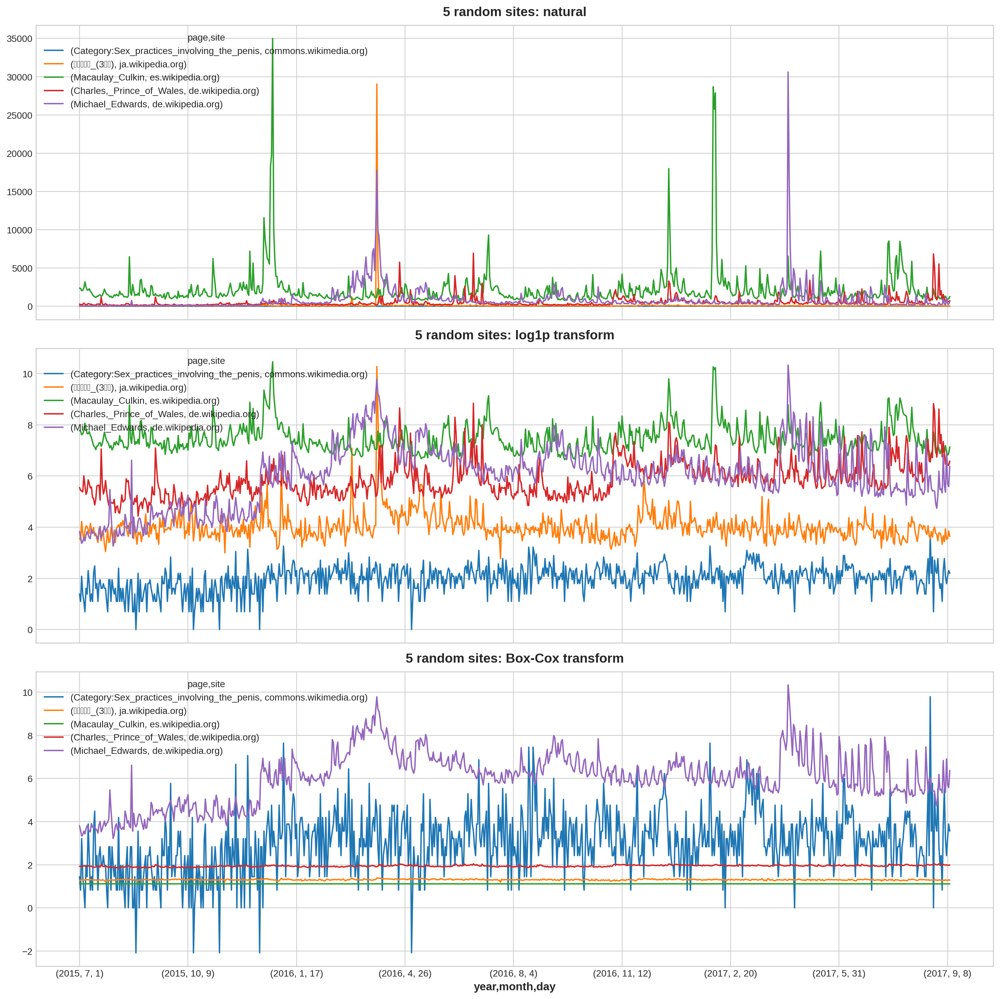

In [19]:
eps = 1e-5 # Small epsilon for Box-Cox transform

plt.figure(figsize=(15,15))

fig, axs = plt.subplots(3,1, sharex=True, figsize=(15,15))

df_rand_plot.plot(ax=axs[0],title=f'{len(rand_indx)} random sites: natural', grid=True)
df_rand_plot.apply(np.log1p).plot(ax=axs[1],title=f'{len(rand_indx)} random sites: log1p transform', grid=True)
df_rand_plot.apply(lambda x: stats.boxcox(x + eps)[0]).plot(ax=axs[2],title=f'{len(rand_indx)} random sites: Box-Cox transform', grid=True)

# 2. Explore some general statistics  <a class="anchor" id="h2"></a>

<span style="color:darkred"> 
    <font size="4">
        Note: 
    </font>
</span>


<font color="darkblue">
<font size="3"> Some NaNs mean real missing values, others are 0's views.
More likely, leading series of nan's mean absens of the article before some date. 
That's why 2 versions of each statistics are used: fair (leading NaN's are not considered) and whole (leading NaN's are filled by 0's)
</font>
</font>


## 2.1 Mean, median, total views  <a class="anchor" id="h2.1"></a>

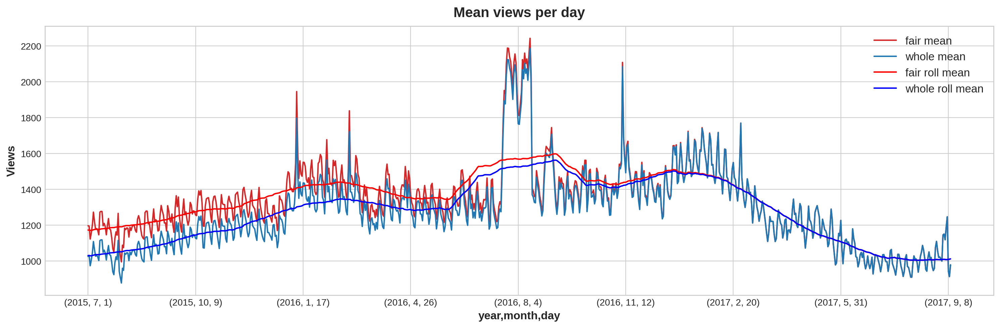

In [618]:
temp = df_train.droplevel(level='weekday',axis=1).iloc[:,:-1].mean().to_frame(name='fair_mean')
temp['whole_mean'] = df_train.droplevel(level='weekday',axis=1).iloc[:,:-1].fillna(0).mean()

window = 100
temp['fair_rolling_mean'] = temp.fair_mean.rolling(window,min_periods=0,center=True).mean()
temp['whole_rolling_mean'] = temp.whole_mean.rolling(window,min_periods=0,center=True).mean()

temp.plot(figsize=(15,5),color=['tab:red','tab:blue','red','blue'], grid=True, title='Mean views per day',ylabel='Views')

plt.title(label='Mean views per day', fontsize=15)
plt.legend(['fair mean','whole mean','fair roll mean','whole roll mean'],fontsize=12)
#plt.ylabel('')
plt.show()

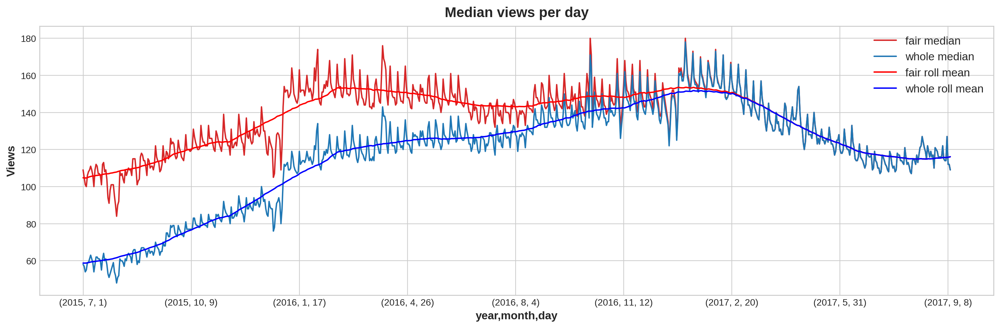

In [21]:
temp = df_train.droplevel(level='weekday',axis=1).iloc[:,:-1].median().to_frame(name='fair_median')
temp['whole_median'] = df_train.droplevel(level='weekday',axis=1).iloc[:,:-1].fillna(0).median()

window = 100
temp['fair_rolling_mean'] = temp.fair_median.rolling(window,min_periods=0,center=True).mean()
temp['whole_rolling_mean'] = temp.whole_median.rolling(window,min_periods=0,center=True).mean()

temp.plot(figsize=(15,5),color=['tab:red','tab:blue','red','blue'], grid=True, title='Mean views per day',ylabel='Views')

plt.title(label='Median views per day', fontsize=15)
plt.legend(['fair median','whole median','fair roll mean','whole roll mean'],fontsize=12, loc='best')
#plt.ylabel('')
plt.show()

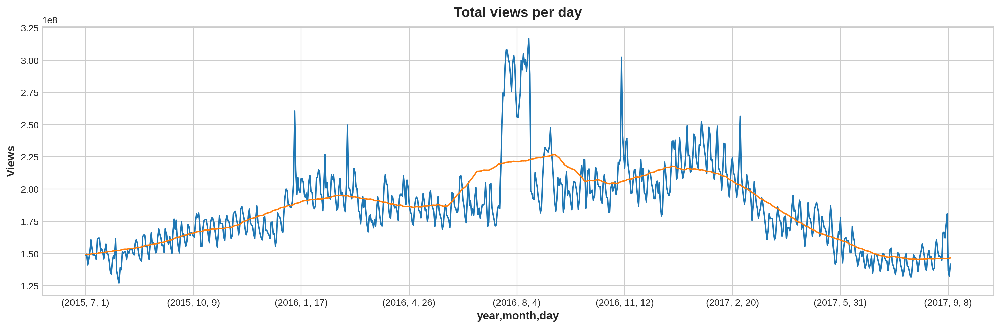

In [22]:
df_train.droplevel(level='weekday',axis=1).iloc[:,:-1].fillna(0).sum().plot(figsize=(15,5),grid=True, ylabel='Views', label='sum')
df_train.droplevel(level='weekday',axis=1).iloc[:,:-1].fillna(0).sum().rolling(100,min_periods=0,center=True).mean().plot(figsize=(15,5),grid=True, label='sum roll mean')
plt.title(label='Total views per day', fontsize=15)

plt.show()

## 2.2 Grouping <a class="anchor" id="h2.2"></a>

### Years

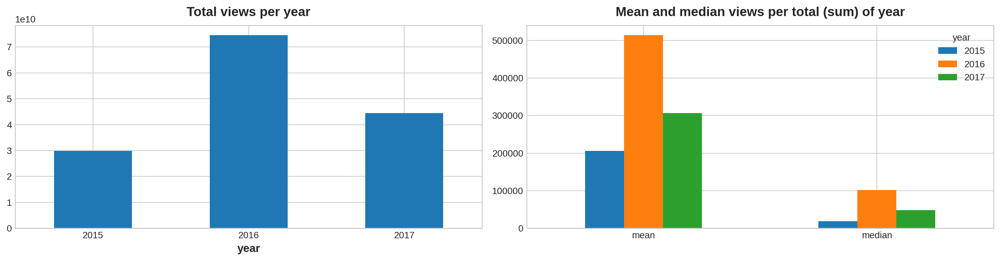

In [23]:
_, axs = plt.subplots(1,2, figsize=(15,4))
df_train.drop('first_day',axis=1).groupby(level='year',axis=1).sum().sum().plot(ax= axs[0], kind='bar',rot=0,title='Total views per year')
plt.grid(axis='y')
df_train.drop('first_day',axis=1).groupby(level='year',axis=1).sum().agg(['mean','median']).plot(ax=axs[1],kind='bar',rot=0,
                                                                                                title='Mean and median views per total (sum) of year')
#axs[0].grid(axis='y')
#axs[1].grid(axis='y')
plt.show()

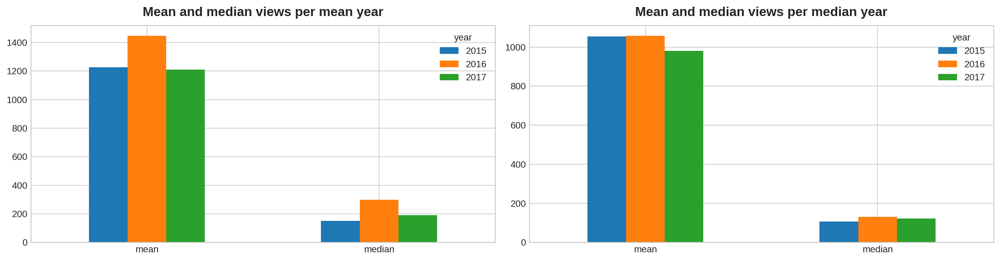

In [24]:
_, axs = plt.subplots(1,2, figsize=(15,4))
df_train.drop('first_day',axis=1).groupby(level='year',axis=1).mean().agg(['mean','median']).plot(ax=axs[0], kind='bar', rot=0,
                                                                                                title='Mean and median views per mean year')
plt.grid(axis='y')
df_train.drop('first_day',axis=1).groupby(level='year',axis=1).median().agg(['mean','median']).plot(ax=axs[1], kind='bar',rot=0,
                                                                                                title='Mean and median views per median year')
#axs[0].grid()
#axs[1].grid(axis='y')
plt.show()

### Months

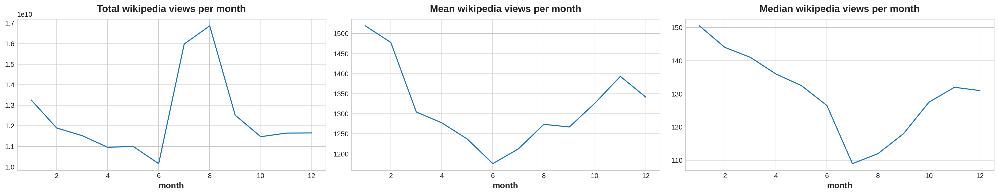

In [25]:
_,axs = plt.subplots(1,3, figsize=(20,4))

df_train.drop('first_day',axis=1).groupby(level='month',axis=1).sum().sum().T.plot(ax=axs[0],rot=0,grid=True,title='Total wikipedia views per month')
df_train.drop('first_day',axis=1).groupby(level='month',axis=1).mean().mean().T.plot(ax=axs[1],rot=0,grid=True,title='Mean wikipedia views per month')
df_train.drop('first_day',axis=1).groupby(level='month',axis=1).median().median().T.plot(ax=axs[2],rot=0,grid=True,title='Median wikipedia views per month')

plt.show()

### Days 

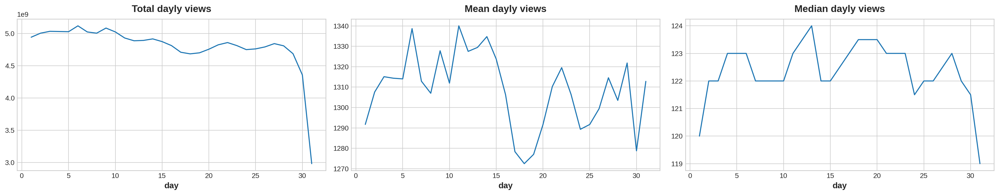

In [26]:
_,axs = plt.subplots(1,3, figsize=(20,4))
df_train.drop('first_day',axis=1).groupby(level='day',axis=1).sum().sum().T.plot(ax=axs[0],grid=True,rot=0,title='Total dayly views')
df_train.drop('first_day',axis=1).groupby(level='day',axis=1).mean().mean().T.plot(ax=axs[1],grid=True,rot=0,title='Mean dayly views')
df_train.drop('first_day',axis=1).groupby(level='day',axis=1).median().median().T.plot(ax=axs[2],grid=True,rot=0,title='Median dayly views')
plt.show()

### Weekdays

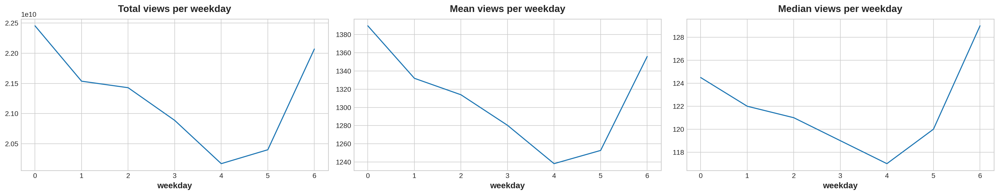

In [27]:
_,axs = plt.subplots(1,3, figsize=(20,4))
df_train.drop('first_day',axis=1).groupby(level='weekday',axis=1).sum().sum().T.plot(ax=axs[0],grid=True,rot=0,title='Total views per weekday')
df_train.drop('first_day',axis=1).groupby(level='weekday',axis=1).mean().mean().T.plot(ax=axs[1],grid=True,rot=0,title='Mean views per weekday')
df_train.drop('first_day',axis=1).groupby(level='weekday',axis=1).median().median().T.plot(ax=axs[2],grid=True,rot=0,title='Median views per weekday')
plt.show()

### Years + Months

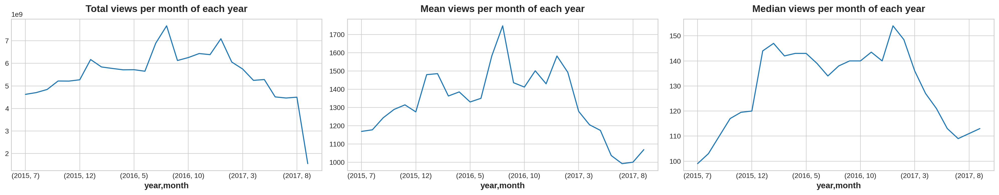

In [28]:
_,axs = plt.subplots(1,3, figsize=(20,4))
df_train.drop('first_day',axis=1).groupby(level=['year','month'],axis=1).sum().sum().T.plot(ax=axs[0],grid=True,rot=0,title='Total views per month of each year')
df_train.drop('first_day',axis=1).groupby(level=['year','month'],axis=1).mean().mean().T.plot(ax=axs[1],grid=True,rot=0,title='Mean views per month of each year')
df_train.drop('first_day',axis=1).groupby(level=['year','month'],axis=1).median().median().T.plot(ax=axs[2],grid=True,rot=0,title='Median views per month of each year')
plt.show()

### Months + Weekday

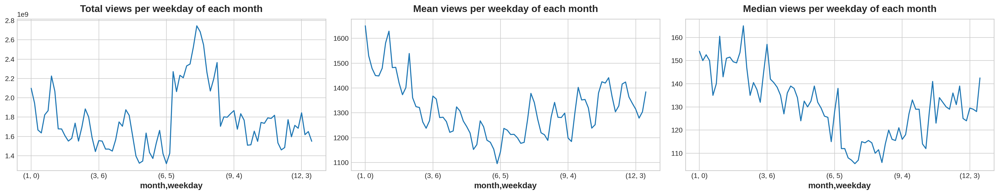

In [29]:
_,axs = plt.subplots(1,3, figsize=(20,4))
df_train.drop('first_day',axis=1).groupby(level=['month','weekday'],axis=1).sum().sum().T.plot(ax=axs[0],grid=True,rot=0,title='Total views per weekday of each month')
df_train.drop('first_day',axis=1).groupby(level=['month','weekday'],axis=1).mean().mean().T.plot(ax=axs[1],grid=True,rot=0,title='Mean views per weekday of each month')
df_train.drop('first_day',axis=1).groupby(level=['month','weekday'],axis=1).median().median().T.plot(ax=axs[2],grid=True,rot=0,title='Median views per weekday of each month')
plt.show()

### Sites (languages)

In [30]:
df_train = df_train.rename(index={s: s.split('.')[0] for s in np.unique(df_train.index.get_level_values(1))})

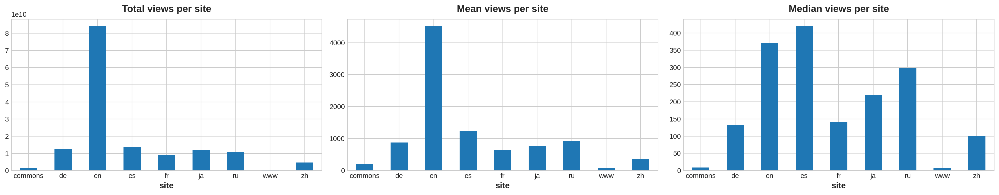

In [31]:
_,axs = plt.subplots(1,3, figsize=(20,4))
df_train.drop('first_day',axis=1).groupby(level='site',axis=0).sum().T.sum().plot(ax=axs[0],kind='bar',rot=0,title='Total views per site')
df_train.drop('first_day',axis=1).groupby(level='site',axis=0).mean().T.mean().plot(ax=axs[1],kind='bar',rot=0,title='Mean views per site')
df_train.drop('first_day',axis=1).groupby(level='site',axis=0).median().T.median().plot(ax=axs[2],kind='bar',rot=0,title='Median views per site')
plt.show()

### Access

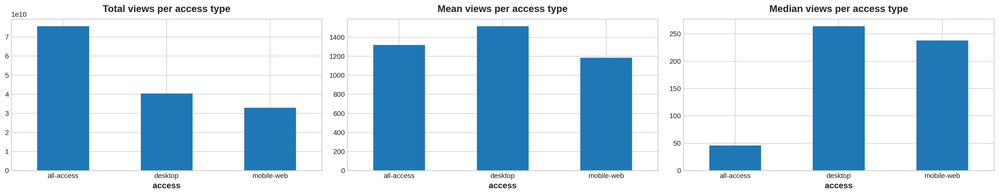

In [32]:
_,axs = plt.subplots(1,3, figsize=(20,4))
df_train.drop('first_day',axis=1).groupby(level='access',axis=0).sum().T.sum().plot(ax=axs[0],kind='bar',rot=0,title='Total views per access type')
df_train.drop('first_day',axis=1).groupby(level='access',axis=0).mean().T.mean().plot(ax=axs[1],kind='bar',rot=0,title='Mean views per access type')
df_train.drop('first_day',axis=1).groupby(level='access',axis=0).median().T.median().plot(ax=axs[2],kind='bar',rot=0,title='Median views per access type')
plt.show()

### Agents

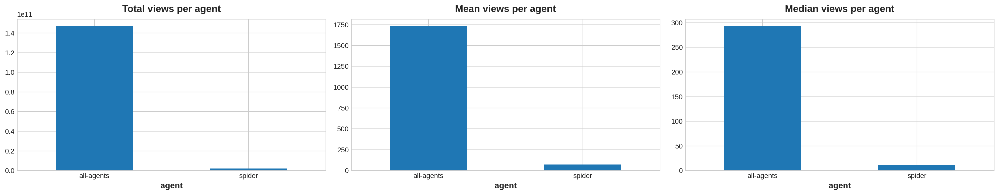

In [33]:
_,axs = plt.subplots(1,3, figsize=(20,4))
df_train.drop('first_day',axis=1).groupby(level='agent',axis=0).sum().T.sum().plot(ax=axs[0],kind='bar',rot=0,title='Total views per agent')
df_train.drop('first_day',axis=1).groupby(level='agent',axis=0).mean().T.mean().plot(ax=axs[1],kind='bar',rot=0,title='Mean views per agent')
df_train.drop('first_day',axis=1).groupby(level='agent',axis=0).median().T.median().plot(ax=axs[2],kind='bar',rot=0,title='Median views per agent')
plt.show()

### Sites + Access 

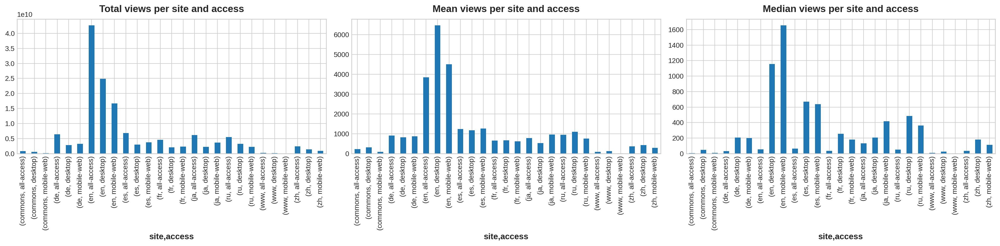

In [34]:
_,axs = plt.subplots(1,3, figsize=(20,5))
df_train.drop('first_day',axis=1).groupby(level=['site','access'],axis=0).sum().T.sum().plot(ax=axs[0],kind='bar',title='Total views per site and access')
df_train.drop('first_day',axis=1).groupby(level=['site','access'],axis=0).mean().T.mean().plot(ax=axs[1],kind='bar',title='Mean views per site and access')
df_train.drop('first_day',axis=1).groupby(level=['site','access'],axis=0).median().T.median().plot(ax=axs[2],kind='bar',title='Median views per site and access')
plt.show()

### Sites + Years

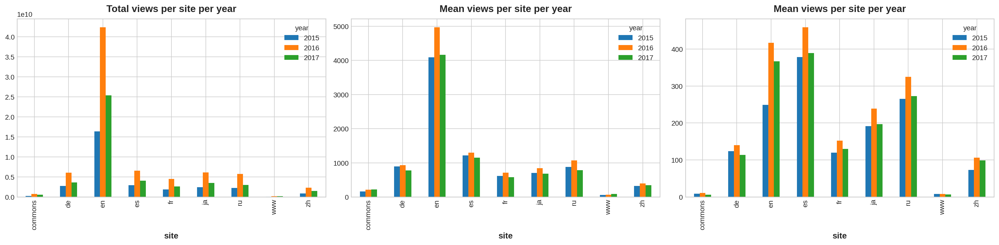

In [35]:
_,axs = plt.subplots(1,3, figsize=(20,5))
df_train.drop('first_day',axis=1).groupby(level='site', axis=0).sum().groupby(level='year',axis=1).sum().plot(ax=axs[0],kind='bar',title='Total views per site per year')
df_train.drop('first_day',axis=1).groupby(level='site', axis=0).mean().groupby(level='year',axis=1).mean().plot(ax=axs[1],kind='bar',title='Mean views per site per year')
df_train.drop('first_day',axis=1).groupby(level='site', axis=0).median().groupby(level='year',axis=1).median().plot(ax=axs[2],kind='bar',title='Mean views per site per year')
plt.show()

### Access + Years

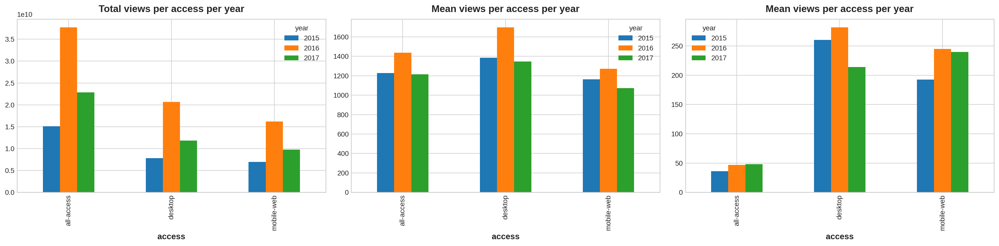

In [36]:
_,axs = plt.subplots(1,3, figsize=(20,5))
df_train.drop('first_day',axis=1).groupby(level='access', axis=0).sum().groupby(level='year',axis=1).sum().plot(ax=axs[0],kind='bar',title='Total views per access per year')
df_train.drop('first_day',axis=1).groupby(level='access', axis=0).mean().groupby(level='year',axis=1).mean().plot(ax=axs[1],kind='bar',title='Mean views per access per year')
df_train.drop('first_day',axis=1).groupby(level='access', axis=0).median().groupby(level='year',axis=1).median().plot(ax=axs[2],kind='bar',title='Mean views per access per year')
plt.show()

### Sites + Weekdays

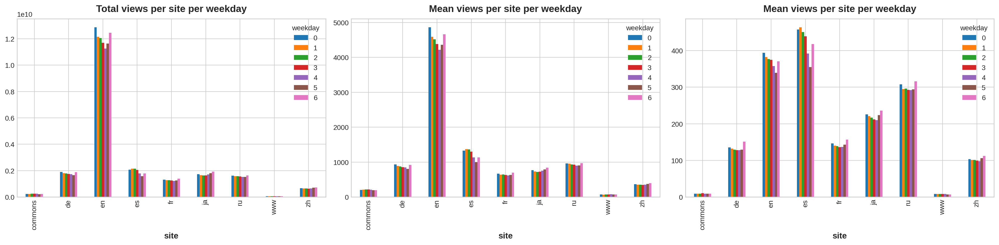

In [37]:
_,axs = plt.subplots(1,3, figsize=(20,5))
df_train.drop('first_day',axis=1).groupby(level='site', axis=0).sum().groupby(level='weekday',axis=1).sum().plot(ax=axs[0],kind='bar',title='Total views per site per weekday')
df_train.drop('first_day',axis=1).groupby(level='site', axis=0).mean().groupby(level='weekday',axis=1).mean().plot(ax=axs[1],kind='bar',title='Mean views per site per weekday')
df_train.drop('first_day',axis=1).groupby(level='site', axis=0).median().groupby(level='weekday',axis=1).median().plot(ax=axs[2],kind='bar',title='Mean views per site per weekday')
plt.show()

### Access + Weekdays

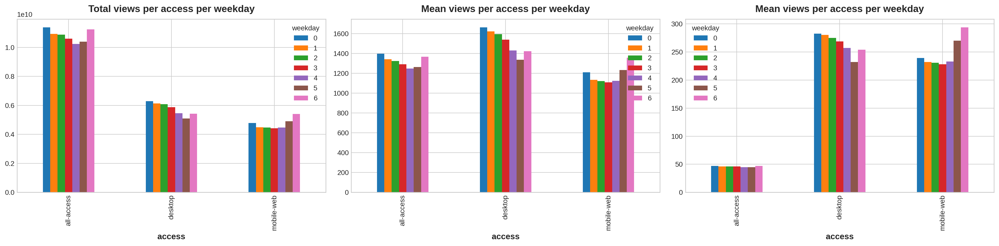

In [38]:
_,axs = plt.subplots(1,3, figsize=(20,5))
df_train.drop('first_day',axis=1).groupby(level='access', axis=0).sum().groupby(level='weekday',axis=1).sum().plot(ax=axs[0],kind='bar',title='Total views per access per weekday')
df_train.drop('first_day',axis=1).groupby(level='access', axis=0).mean().groupby(level='weekday',axis=1).mean().plot(ax=axs[1],kind='bar',title='Mean views per access per weekday')
df_train.drop('first_day',axis=1).groupby(level='access', axis=0).median().groupby(level='weekday',axis=1).median().plot(ax=axs[2],kind='bar',title='Mean views per access per weekday')
plt.show()

### Months + weekdays heatmap

Text(0.5, 1.0, 'Median visits per month per weekday')

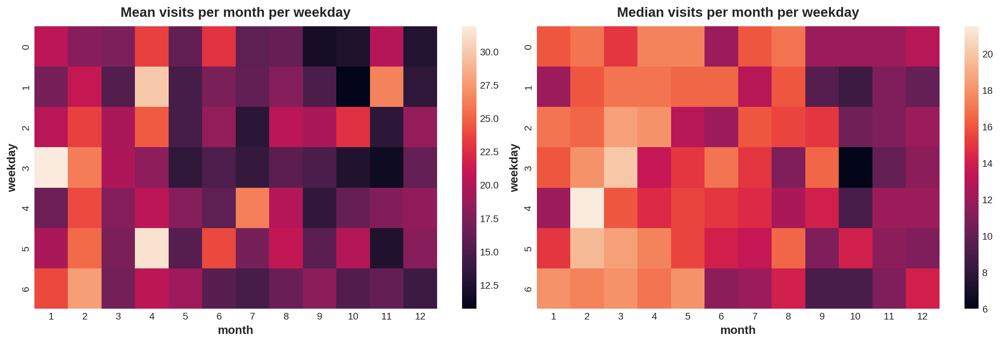

In [39]:
_,axs = plt.subplots(1,2, figsize=(15,5))
data_mean = df_train.iloc[:,:-1].head().groupby(level=['month','weekday'], axis=1).mean().mean().to_frame(name='visits').reset_index().pivot('weekday','month','visits')
data_median = df_train.iloc[:,:-1].head().groupby(level=['month','weekday'], axis=1).median().median().to_frame(name='visits').reset_index().pivot('weekday','month','visits')
sns.heatmap(data_mean,ax=axs[0])
sns.heatmap(data_median,ax=axs[1])
axs[0].set_title('Mean visits per month per weekday')
axs[1].set_title('Median visits per month per weekday')

# 3. Analysis of Wiki trends and lags  <a class="anchor" id="h3"></a>

<font color="darkblue">
<font size="4">
Further, I explore the median as the most stable and meaningful statistics through all above considered
</font>
</font>

In [40]:
temp = df_train.droplevel(level='weekday',axis=1).iloc[:,:-1].median().to_frame(name='fair_median')

In [41]:
temp['time'] = np.arange(len(temp.index))
temp['lag1'] = temp.fair_median.shift(1)

In [42]:
temp

fair_median  time   lag1
year month day                          
2015 7     1          109.0     0    NaN
           2          105.0     1  109.0
           3          101.0     2  105.0
           4          100.0     3  101.0
           5          106.0     4  100.0
...                     ...   ...    ...
2017 9     6          114.0   798  114.0
           7          127.0   799  114.0
           8          112.0   800  127.0
           9          112.0   801  112.0
           10         109.0   802  112.0

[803 rows x 3 columns]

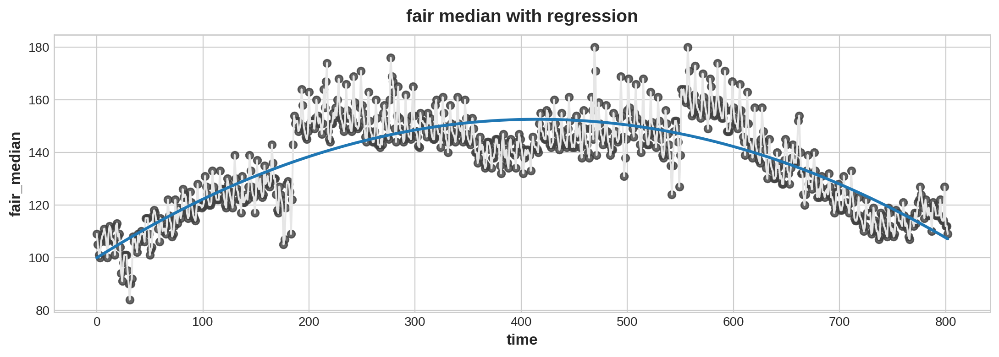

In [43]:
fig, ax = plt.subplots()
ax.plot('time', 'fair_median', data=temp, color='0.9')
ax = sns.regplot(x='time', y='fair_median', data=temp, ci=None, scatter_kws=dict(color='0.25'), order = 2)
ax.set_title('fair median with regression');

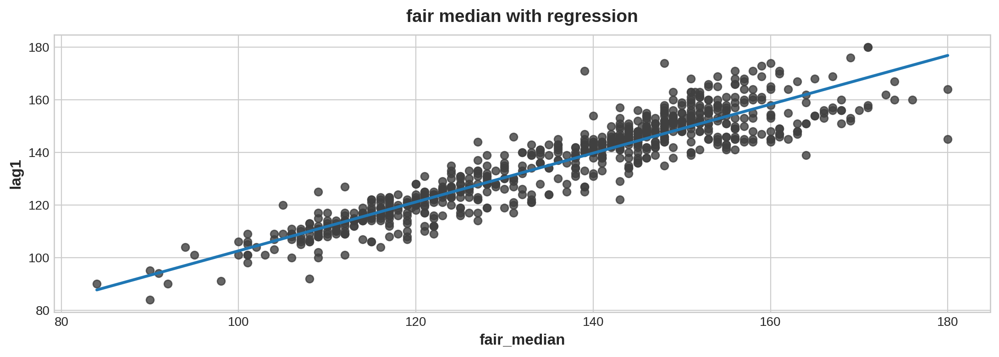

In [44]:
fig, ax = plt.subplots()
#ax.plot('lag1', 'fair_median', data=temp, color='0.9')
ax = sns.regplot(x='fair_median', y='lag1', data=temp, ci=None, scatter_kws=dict(color='0.25'), order = 1)
ax.set_title('fair median with regression');

# 4. Building some linear models for median data  <a class="anchor" id="h4"></a>

In [658]:
from statsmodels.tsa.deterministic import DeterministicProcess, CalendarFourier, Fourier

dp = DeterministicProcess(
    index=temp.index,    # dates from the training data
    constant=True,       # dummy feature for the bias (y_intercept)
    order=5,             # the time dummy (trend)
    #drop=True,           # drop terms if necessary to avoid collinearity
)
# `in_sample` creates features for the dates given in the `index` argument
X = dp.in_sample()

X

,const,trend,trend_squared,trend_cubed,trend**4,trend**5
date,,,,,,
2015-07-01,1.0,1.0,1.0,1.0,1.000000e+00,1.000000e+00
2015-07-02,1.0,2.0,4.0,8.0,1.600000e+01,3.200000e+01
2015-07-03,1.0,3.0,9.0,27.0,8.100000e+01,2.430000e+02
2015-07-04,1.0,4.0,16.0,64.0,2.560000e+02,1.024000e+03
2015-07-05,1.0,5.0,25.0,125.0,6.250000e+02,3.125000e+03
...,...,...,...,...,...,...
2017-09-06,1.0,799.0,638401.0,510082399.0,4.075558e+11,3.256371e+14
2017-09-07,1.0,800.0,640000.0,512000000.0,4.096000e+11,3.276800e+14
2017-09-08,1.0,801.0,641601.0,513922401.0,4.116518e+11,3.297331e+14


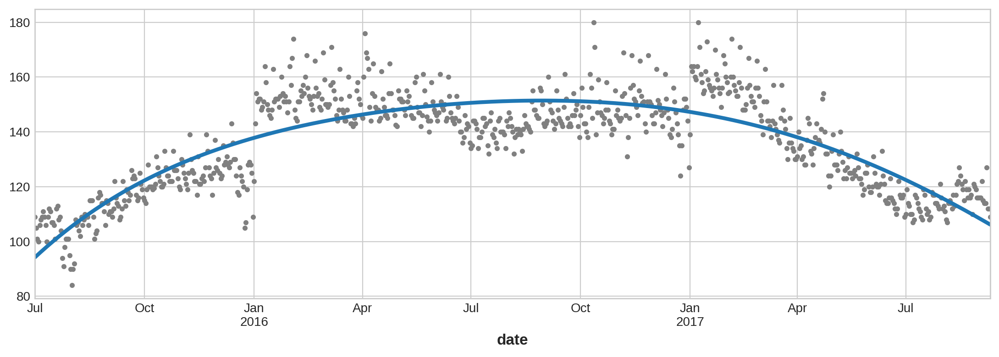

In [659]:
y = temp.fair_median
model = LinearRegression(fit_intercept=False)
model.fit(X,y)
y_pred = pd.Series(model.predict(X),index=X.index)

ax = y.plot(style='.',color='0.5')
ax = y_pred.plot(ax=ax,linewidth=3,label='Trend')

In [660]:
X = dp.out_of_sample(50)
y_fore = pd.Series(model.predict(X), index=X.index)
y_fore.head()

2017-09-11    105.908578
2017-09-12    105.655718
2017-09-13    105.402316
2017-09-14    105.148376
2017-09-15    104.893902
Freq: D, dtype: float64

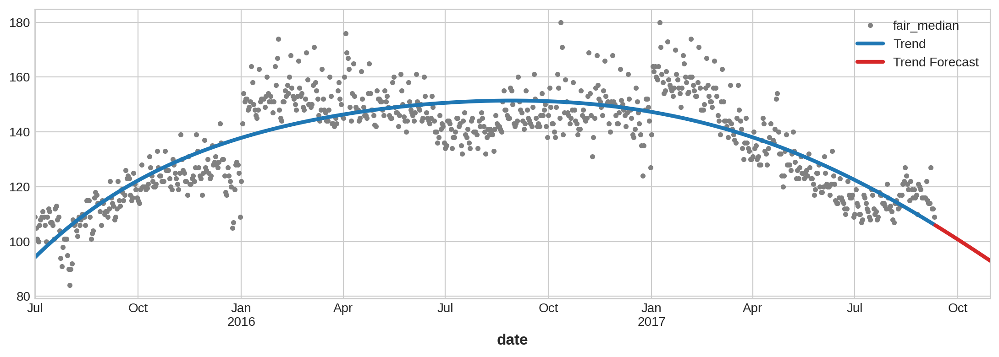

In [661]:
ax = y.plot(style='.',color='0.5')
ax = y_pred.plot(ax=ax,linewidth=3,label='Trend')
ax = y_fore.plot(ax=ax, linewidth=3, label="Trend Forecast", color="C3")
_ = ax.legend()

## 4.1 Exploring seasonality <a class="anchor" id="h4.1"></a>

In [662]:
from scipy.signal import periodogram, welch
from scipy import fft

In [663]:
temp = df_train.droplevel(level='weekday',axis=1).iloc[:,:-1].median().to_frame(name='fair_median')
temp

fair_median
year month day             
2015 7     1          109.0
           2          105.0
           3          101.0
           4          100.0
           5          106.0
...                     ...
2017 9     6          114.0
           7          127.0
           8          112.0
           9          112.0
           10         109.0

[803 rows x 1 columns]

In [664]:
temp['date'] = [datetime.datetime(*s) for s in temp.index]

In [665]:
temp = temp.reset_index().set_index('date').to_period('D')
temp['dayofweek'] = temp.index.dayofweek
temp['week'] = temp.index.week
temp['dayofyear'] = temp.index.dayofyear
temp

,year,month,day,fair_median,dayofweek,week,dayofyear
date,,,,,,,
2015-07-01,2015,7,1,109.0,2,27,182
2015-07-02,2015,7,2,105.0,3,27,183
2015-07-03,2015,7,3,101.0,4,27,184
2015-07-04,2015,7,4,100.0,5,27,185
2015-07-05,2015,7,5,106.0,6,27,186
...,...,...,...,...,...,...,...
2017-09-06,2017,9,6,114.0,2,36,249
2017-09-07,2017,9,7,127.0,3,36,250
2017-09-08,2017,9,8,112.0,4,36,251


In [666]:
# annotations: https://stackoverflow.com/a/49238256/5769929
def seasonal_plot(X, y, period, freq, ax=None):
    if ax is None:
        _, ax = plt.subplots()
    palette = sns.color_palette("husl", n_colors=X[period].nunique(),)
    ax = sns.lineplot(
        x=freq,
        y=y,
        hue=period,
        data=X,
        ax=ax,
        palette=palette,
        legend=False,
    )
    ax.set_title(f"Seasonal Plot ({period}/{freq})",fontsize=12)
    for line, name in zip(ax.lines, X[period].unique()):
        y_ = line.get_ydata()[-1]
        ax.annotate(
            name,
            xy=(1, y_),
            xytext=(6, 0),
            color=line.get_color(),
            xycoords=ax.get_yaxis_transform(),
            textcoords="offset points",
            size=12,
            va="center",
        )
    return ax

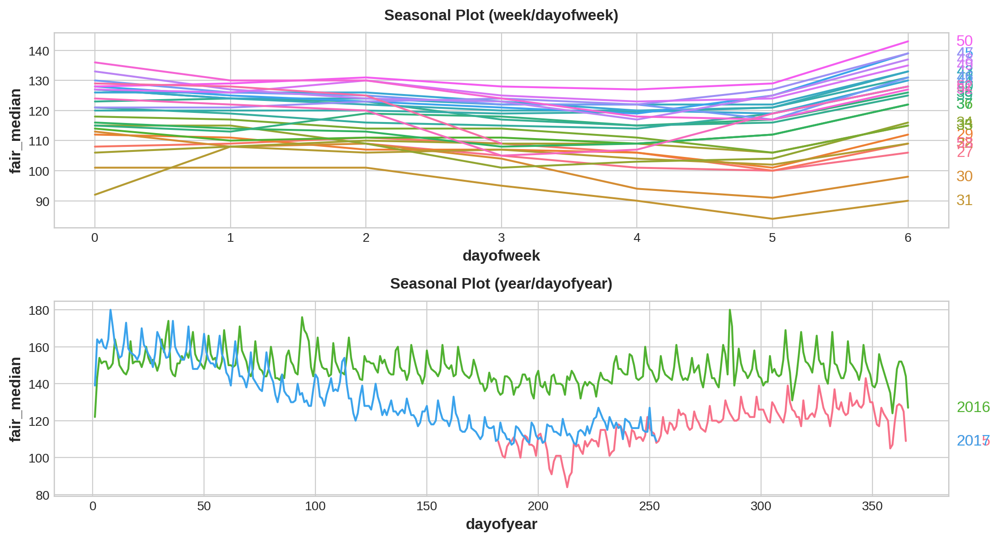

In [667]:
fig, (ax0, ax1) = plt.subplots(2, 1, figsize=(11, 6))
seasonal_plot(temp[temp.year==2015], y="fair_median", period="week", freq="dayofweek", ax=ax0)
seasonal_plot(temp, y="fair_median", period="year", freq="dayofyear", ax=ax1);

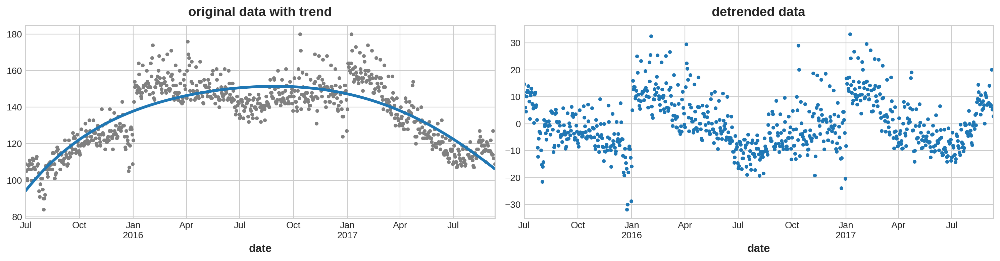

In [668]:
''' Detrending of the median data for fourier decomposition'''
X = dp.in_sample()
y = temp.fair_median
model = LinearRegression()
model.fit(X,y)
y_pred = pd.Series(model.predict(X),index=y.index)

fig, (ax0, ax1) = plt.subplots(1,2, figsize=(15,4))
ax0 = y.plot(ax= ax0, style='.',color='0.5', title='original data with trend')
ax0 = y_pred.plot(ax = ax0, linewidth=3)

dy = y - y_pred
ax1 = dy.plot(ax=ax1, style='.', title='detrended data')

Text(0.5, 1.0, 'No window')

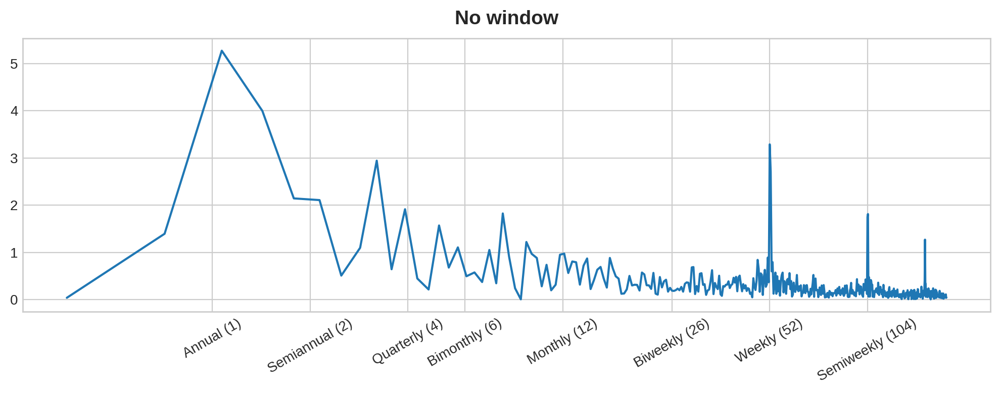

In [669]:
N = int(2**np.ceil(np.log2(dy.size)))

dy_fft = fft.fft(dy.values, n=N)

freq = [k/N * 365 for k in range(N//2)]

_, ax = plt.subplots(figsize=(10,4))
ax.plot(freq[1:], 2/N * np.abs(dy_fft[1:N//2]))

ax.set_xscale("log")
ax.set_xticks([1, 2, 4, 6, 12, 26, 52, 104])
ax.set_xticklabels(
    ["Annual (1)",
     "Semiannual (2)",
     "Quarterly (4)",
     "Bimonthly (6)",
     "Monthly (12)",
     "Biweekly (26)",
     "Weekly (52)",
     "Semiweekly (104)",
     ],
     rotation=30,
)
ax.ticklabel_format(axis="y", style="sci", scilimits=(0, 0))
ax.set_title('No window')

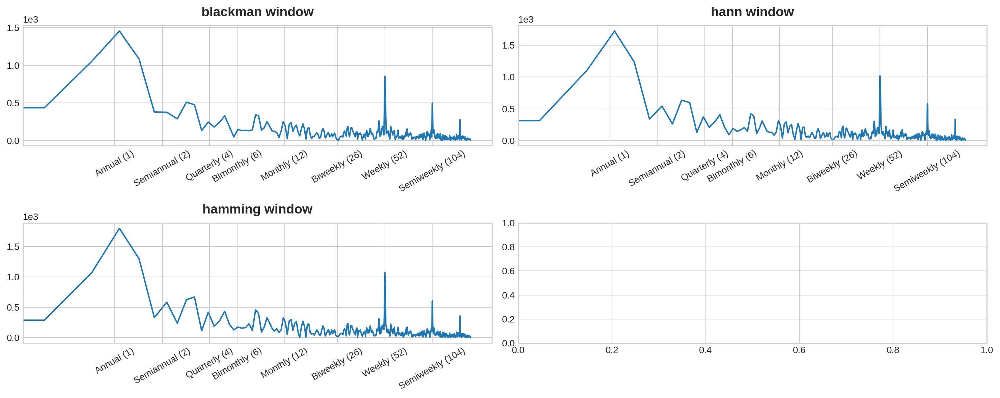

In [670]:
from scipy.signal.windows import blackman, hann, hamming

wins = [blackman(dy.size), hann(dy.size), hamming(dy.size)] 
wins_name = ['blackman','hann','hamming']

N = int(2**np.ceil(np.log2(dy.size)))
freq = [k/N * 365 for k in range(N//2)]

fig, axs = plt.subplots(int(np.ceil(len(wins)/2)), 2, figsize=(15,6))

for i, (w, w_name) in enumerate(zip(wins, wins_name)):  
    
    dy_fft_win = fft.fft(dy.values*w, n=N)
    axs[i//2,i%2].plot(freq,np.abs(dy_fft_win[:N//2]))
    
    axs[i//2,i%2].set_xscale("log")
    axs[i//2,i%2].set_xticks([1, 2, 4, 6, 12, 26, 52, 104])
    axs[i//2,i%2].set_xticklabels(
        [
            "Annual (1)",
            "Semiannual (2)",
            "Quarterly (4)",
            "Bimonthly (6)",
            "Monthly (12)",
            "Biweekly (26)",
            "Weekly (52)",
            "Semiweekly (104)",
        ],
       rotation=30,
    )
    axs[i//2,i%2].ticklabel_format(axis="y", style="sci", scilimits=(0, 0))
    axs[i//2,i%2].set_title(f"{w_name} window")


In [671]:
def plot_periodogram(ts, detrend='linear', method = periodogram, ax=None):
    fs = 365.2425 # pd.Timedelta("1Y") / pd.Timedelta("1D")
    method_kwargs = {'x': ts,
                     'fs': fs,
                     'detrend': detrend,
                     'window': 'hann',
                     'scaling': 'spectrum'}
    freqencies, spectrum = method(**method_kwargs)
    #freqencies, spectrum = periodogram(
    #    ts,
    #    fs=fs,
    #    detrend=detrend,
    #    window="hann",
    #    scaling='spectrum',
    #)
    if ax is None:
        _, ax = plt.subplots()
    ax.step(freqencies, spectrum, color="purple")
    ax.set_xscale("log")
    ax.set_xticks([1, 2, 4, 6, 12, 26, 52, 104])
    ax.set_xticklabels(
        [
            "Annual (1)",
            "Semiannual (2)",
            "Quarterly (4)",
            "Bimonthly (6)",
            "Monthly (12)",
            "Biweekly (26)",
            "Weekly (52)",
            "Semiweekly (104)",
        ],
       rotation=30,
    )
    ax.ticklabel_format(axis="y", style="sci", scilimits=(0, 0))
    ax.set_ylabel("Variance")
    ax.set_title("Periodogram")
    return ax

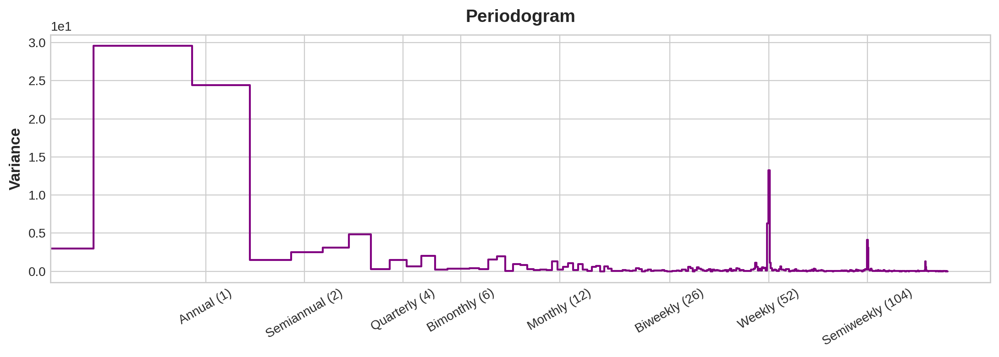

In [672]:
plot_periodogram(dy);

-----------------------------------------

## 4.2 Using fourier series for regression <a class="anchor" id="h4.2"></a>

In [673]:
fourier = CalendarFourier('A',12)
#four = Fourier(period=365.25, order=2)

dp = DeterministicProcess(
    index = temp.index,
    constant=True,
    order = 2, 
    seasonal=True,
    additional_terms=[fourier]
)

X = dp.in_sample()

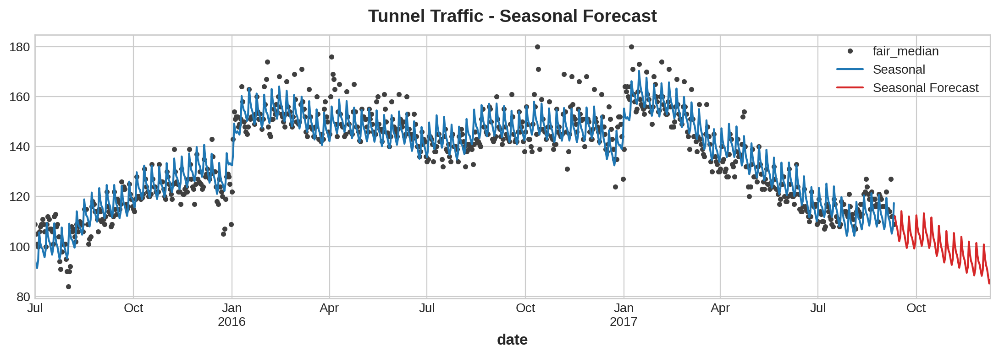

In [674]:
y = temp["fair_median"]

model = LinearRegression(fit_intercept=False)
_ = model.fit(X, y)

y_pred = pd.Series(model.predict(X), index=y.index)
X_fore = dp.out_of_sample(steps=90)
y_fore = pd.Series(model.predict(X_fore), index=X_fore.index)

ax = y.plot(color='0.25', style='.', title="Tunnel Traffic - Seasonal Forecast")
ax = y_pred.plot(ax=ax, label="Seasonal")
ax = y_fore.plot(ax=ax, label="Seasonal Forecast", color='C3')
_ = ax.legend()

## 4.3 Exploring values of different lags  <a class="anchor" id="h4.3"></a>

In [675]:
# Plot some lags along with the corretion coefficent 

from matplotlib.offsetbox import AnchoredText
import math

def lagplot(x, y=None, lag=1, standardize=False, ax=None, **kwargs):
    
    x_ = x.shift(lag)
    if standardize:
        x_ = (x_ - x_.mean()) / x_.std()
    if y is not None:
        y_ = (y - y.mean()) / y.std() if standardize else y
    else:
        y_ = x
    corr = y_.corr(x_)
    if ax is None:
        fig, ax = plt.subplots()
    scatter_kws = dict(
        alpha=0.75,
        s=3,
    )
    line_kws = dict(color='C3', )
    ax = sns.regplot(x=x_,
                     y=y_,
                     scatter_kws=scatter_kws,
                     line_kws=line_kws,
                     lowess=True,
                     ax=ax,
                     **kwargs)
    at = AnchoredText(
        f"{corr:.2f}",
        prop=dict(size="large"),
        frameon=True,
        loc="upper left",
    )
    at.patch.set_boxstyle("square, pad=0.0")
    ax.add_artist(at)
    ax.set(title=f"Lag {lag}", xlabel=x_.name, ylabel=y_.name)
    return ax

def plot_lags(x, y=None, lags=6, nrows=1, lagplot_kwargs={}, **kwargs):
    
    kwargs.setdefault('nrows', nrows)
    kwargs.setdefault('ncols', math.ceil(lags / nrows))
    kwargs.setdefault('figsize', (kwargs['ncols'] * 2, nrows * 2 + 0.5))
    fig, axs = plt.subplots(sharex=True, sharey=True, squeeze=False, **kwargs)
    for ax, k in zip(fig.get_axes(), range(kwargs['nrows'] * kwargs['ncols'])):
        if k + 1 <= lags:
            ax = lagplot(x, y, lag=k + 1, ax=ax, **lagplot_kwargs)
            ax.set_title(f"Lag {k + 1}", fontdict=dict(fontsize=14))
            ax.set(xlabel="", ylabel="")
        else:
            ax.axis('off')
    plt.setp(axs[-1, :], xlabel=x.name)
    plt.setp(axs[:, 0], ylabel=y.name if y is not None else x.name)
    fig.tight_layout(w_pad=0.1, h_pad=0.1)
    return fig

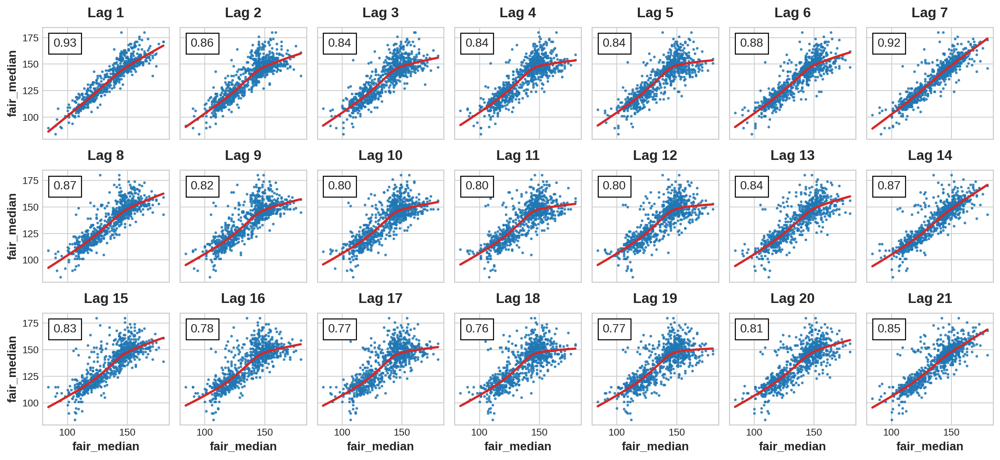

In [676]:
_ = plot_lags(temp.fair_median, lags=21, nrows=3)

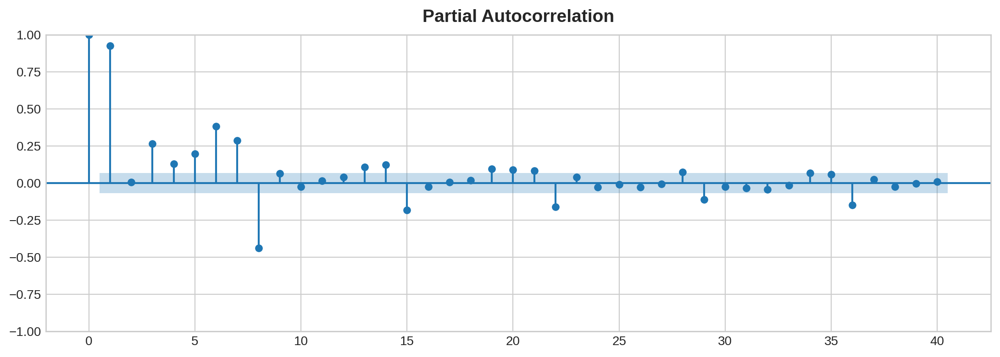

In [677]:
_ = plot_pacf(temp.fair_median, lags=40, method='ywm')

In [678]:
def make_lags(ts, n_lags):
    return pd.concat(
        {
            f'y_lag_{i}': ts.shift(i) 
            for i in range(1,n_lags+1)
        }, 
        axis = 1, 
        join='inner')

def make_lags_scores(ts, y=None, n_lags = 1):    
    
    X = make_lags(ts, n_lags).dropna()
    
    if y is None:        
        y_ = ts.loc[X.index]
    
    #for colname in X.select_dtypes(["object", "category"]):
    #    X[colname], _ = X[colname].factorize()
    # All discrete features should now have integer dtypes
    #discrete_features = [pd.api.types.is_integer_dtype(t) for t in X.dtypes]
    mi_scores = mutual_info_regression(X, y_, random_state=0)
    mi_scores = pd.Series(mi_scores, name="MI Scores", index=X.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores


def plot_mi_scores(scores):
    bar_width = scores.sort_values(ascending=True)
    y_coordinates = np.arange(len(scores))
    ticks = list(scores.sort_values(ascending=True).index)
    plt.figure(figsize=(12,5))
    plt.barh(y_coordinates, bar_width)
    plt.yticks(y_coordinates, ticks)
    plt.title("Mutual Information Scores")

In [679]:
make_lags(temp.fair_median,3).dropna().head()

,y_lag_1,y_lag_2,y_lag_3
date,,,
2015-07-04,101.0,105.0,109.0
2015-07-05,100.0,101.0,105.0
2015-07-06,106.0,100.0,101.0
2015-07-07,108.0,106.0,100.0
2015-07-08,109.0,108.0,106.0


In [680]:
mi_scores = make_lags_scores(temp.fair_median, n_lags=40)
#mi_scores

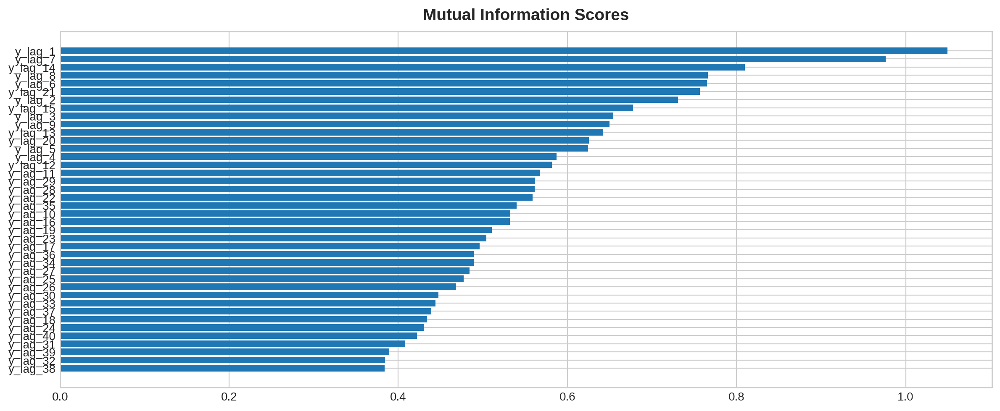

In [681]:
plot_mi_scores(mi_scores)

In [682]:
fourier = CalendarFourier('A',2)
#four = Fourier(period=365.25, order=2)

dp = DeterministicProcess(
    index = temp.index,
    constant=True,
    order = 2, 
    seasonal=True,
    additional_terms=[fourier]
)

X = dp.in_sample()

In [683]:
X = dp.in_sample()
y = temp.fair_median

Text(0.5, 1.0, 'Deseasoned plot')

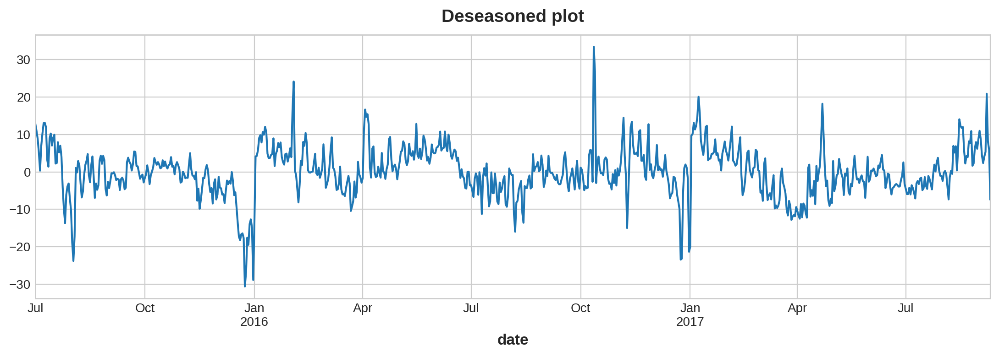

In [684]:
model = LinearRegression(fit_intercept=False).fit(X, y)

y_deseason = temp.fair_median - model.predict(X)

ax = y_deseason.plot()
ax.set_title("Deseasoned plot")

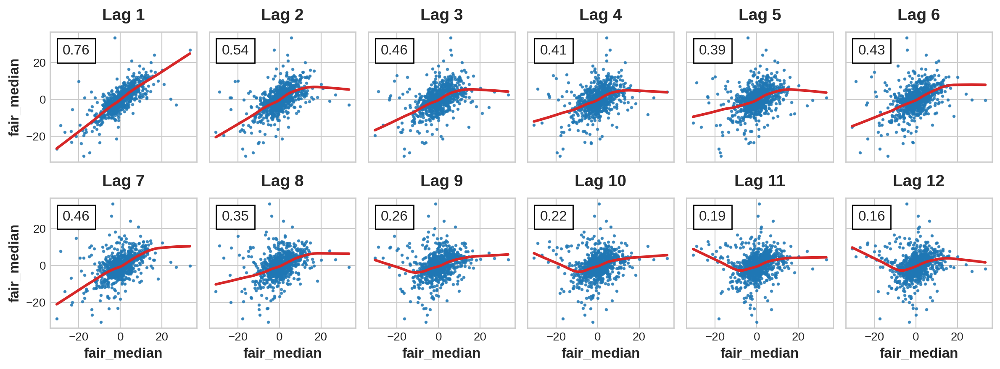

In [685]:
_ = plot_lags(y_deseason,lags=12,nrows=2)

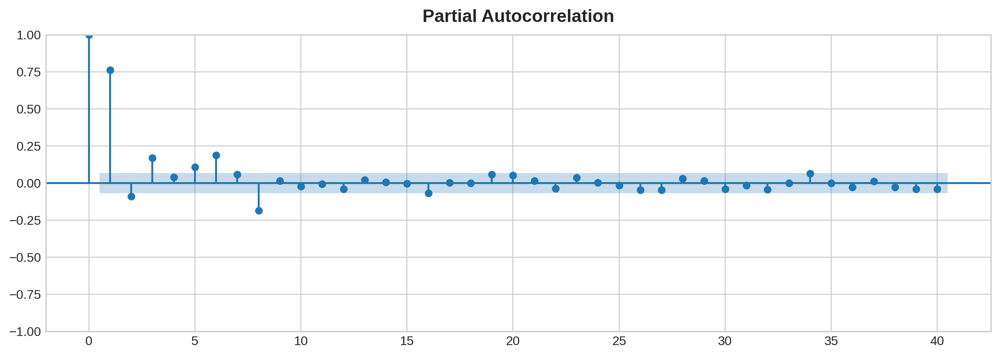

In [686]:
_ = plot_pacf(y_deseason, lags=40, method='ywm')

In [687]:
mi_scores = make_lags_scores(y_deseason, n_lags=20)
#mi_scores

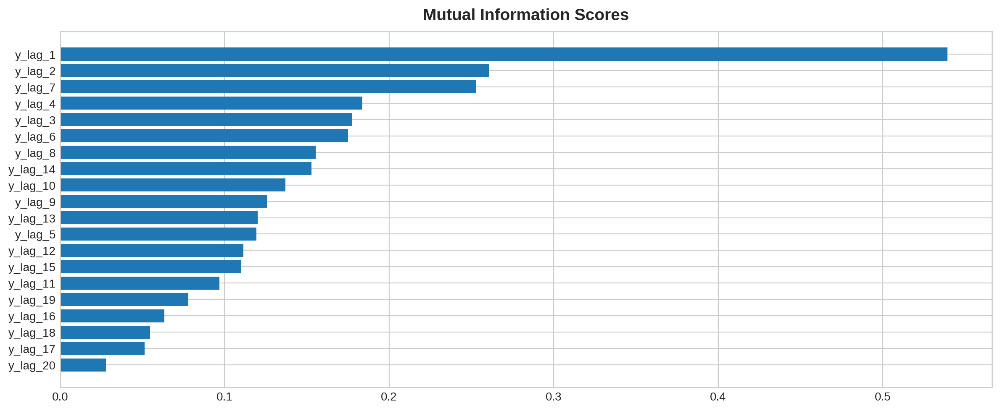

In [688]:
plot_mi_scores(mi_scores)

In [689]:
# Numbers of days to predict:
n_test_days = (datetime.date(2017,11,13) - datetime.date(2017,9,13)).days
n_test_days

61

## 4.4 Exploring performance of several linear models <a class="anchor" id="h4.4"></a>

In [690]:
def normalization(series): 
    return (series - np.mean(series))/np.std(series)

In [691]:
def smape(Ft, At):    
    denom = (np.abs(At) + np.abs(Ft))/2
    diff = np.abs(Ft - At)/denom
    diff[denom == 0] = 0
    
    return np.nanmean(diff)*100

In [719]:
def prediction_plot(series_true, series_fit, series_pred, ax=None, smape_val=None, **kwargs):   
   
    assert len(series_true) == len(series_fit) + len(series_pred), 'Inappropriate array sizes'
    
    if ax is None:
        fig, ax = plt.subplots()     
    
    ax = series_true.plot(ax = ax, color='0.25', alpha =0.4, style = '-',marker='.', **kwargs) #, title=f'{name}, n_fourier = {n_fourier}')
    ax = series_fit.plot(ax=ax, label = 'Fitted', color='C0')
    ax = series_pred.plot(ax=ax, label = 'Forecast', color='C3')
    ax.legend()
    
    #kwargs.setdefault('prop', dict(size=14))
    #kwargs.setdefault('loc', 'lower center')
    
    if smape_val:
        at = AnchoredText(
            f"smape = {smape_val:.2f}",
            prop=dict(size=14),
            #prop = kwargs['prop'],
            frameon=True,
            loc="lower left",
            #loc = kwargs['loc']
        )
        at.patch.set_boxstyle("square, pad=0.0")
        ax.add_artist(at)
        
    return ax      
    

In [720]:
def model_eval(model, model_name, nfour, y):
    
    smape_results = {}
    
    for ax, n_fourier in zip(fig.get_axes(), range(1, nfour + 1)):
        
        fourier = CalendarFourier('A',n_fourier)

        dp = DeterministicProcess(
            index = y.index,
            constant=True,
            order = 2, 
            seasonal=True,
            #drop=True,
            additional_terms=[fourier]
        )

        X = dp.in_sample()    
        
        X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=n_test_days, shuffle=False)
    
        model.fit(X_train, np.log1p(y_train))
    
        y_fit = np.expm1(pd.Series(model.predict(X_train), index=X_train.index))
        y_pred = np.expm1(pd.Series(model.predict(X_valid), index=X_valid.index))
    
        smape_value = smape(y_pred, y_valid)
    
        smape_results[n_fourier] = smape_value
    
        predplot_kwargs = {'ylabel':'fair median', 'title': f'{model_name}, n_fourier = {n_fourier}'}
    
        prediction_plot(y[-(300+n_test_days):], y_fit[-300:], y_pred, ax=ax, smape_val = smape_value, **predplot_kwargs)
        
    return smape_results

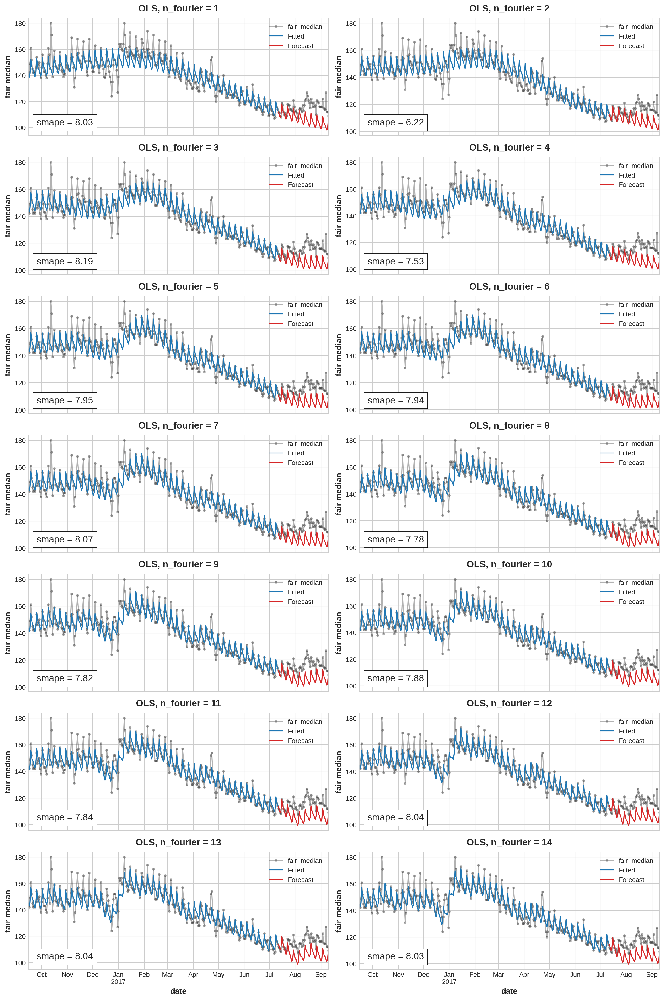

In [721]:
y = temp.fair_median

estimators = [
    ("OLS", LinearRegression()),
    #("Theil-Sen", TheilSenRegressor(random_state=42)),
    #("RANSAC", RANSACRegressor(random_state=42)),
    ("HuberRegressor", HuberRegressor(epsilon=1)),
]
 
nfour = 14
ncols = 2
nrows = math.ceil(nfour/ncols)

#df_smape_results = pd.DataFrame(index=range(1,nfour+1))

fig, axs = plt.subplots(nrows=nrows, ncols = ncols, sharex=True, sharey=False, figsize=(ncols*7,nrows*3))

smape_OLS = model_eval(LinearRegression(), 'OLS', nfour, y)   

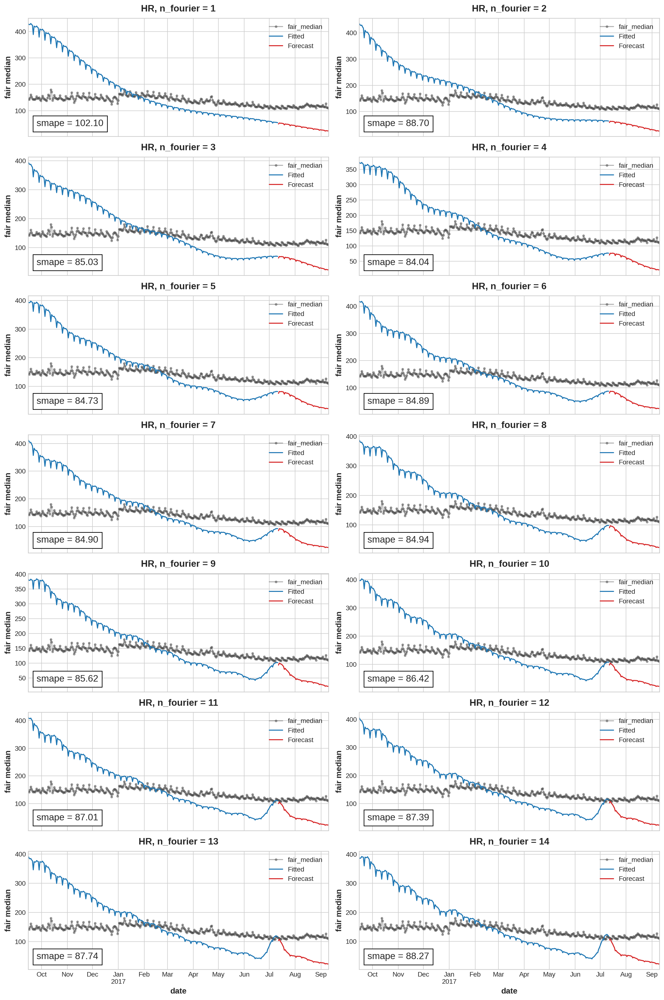

In [771]:
y = temp.fair_median

estimators = [
    ("OLS", LinearRegression()),
    #("Theil-Sen", TheilSenRegressor(random_state=42)),
    #("RANSAC", RANSACRegressor(random_state=42)),
    ("HuberRegressor", HuberRegressor(epsilon=1)),
]
 
nfour = 14
ncols = 2
nrows = math.ceil(nfour/ncols)

#df_smape_results = pd.DataFrame(index=range(1,nfour+1))

fig, axs = plt.subplots(nrows=nrows, ncols = ncols, sharex=True, sharey=False, figsize=(ncols*7,nrows*3))

smape_HR = model_eval(HuberRegressor(epsilon=1e3,max_iter=1e5, alpha=1e-5), 'HR', nfour, y)   

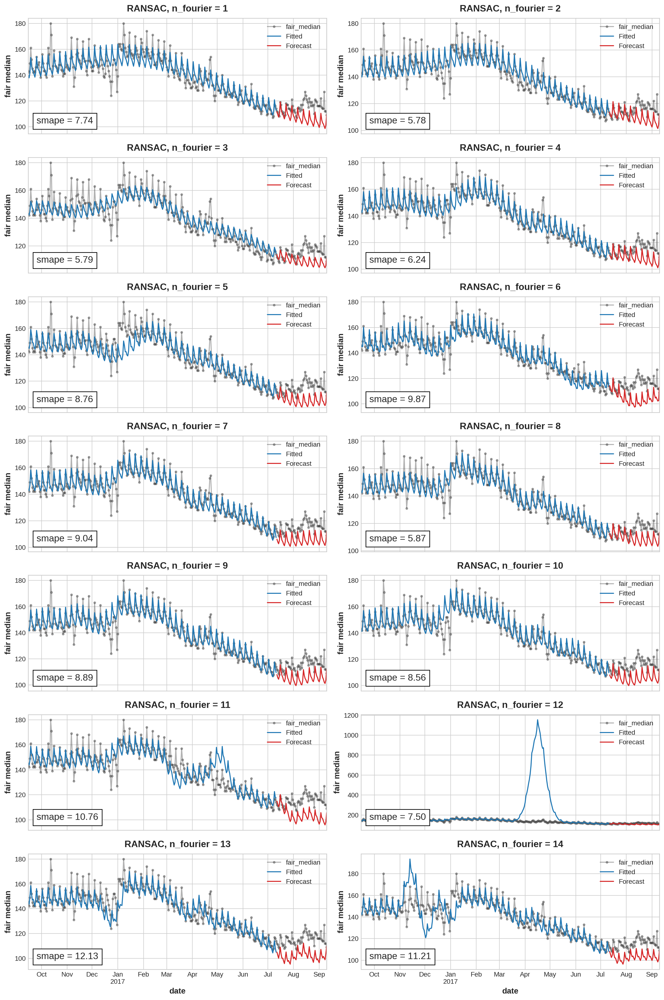

In [772]:
y = temp.fair_median

estimators = [
    ("OLS", LinearRegression()),
    #("Theil-Sen", TheilSenRegressor(random_state=42)),
    #("RANSAC", RANSACRegressor(random_state=42)),
    ("HuberRegressor", HuberRegressor(epsilon=1)),
]
 
nfour = 14
ncols = 2
nrows = math.ceil(nfour/ncols)

#df_smape_results = pd.DataFrame(index=range(1,nfour+1))

fig, axs = plt.subplots(nrows=nrows, ncols = ncols, sharex=True, sharey=False, figsize=(ncols*7,nrows*3))

smape_RANSAC = model_eval(RANSACRegressor(random_state=42), 'RANSAC', nfour, y)   

<span style="color:darkred"> 
    <font size="4"> 
        Note 2: 
    </font> 
</span>

<font color="darkblue">
<font size="3"> Finally, sinse I didn't get anything reasonable from HubberRegressor, I settled on OLS and RANSAC for further experiment in this part. 
</font>
</font>


## 4.5 Some feature engineering  <a class="anchor" id="h4.5"></a> 

Adding to the feature list some statistics estimated from the training part of the time series.

In [382]:
def add_period_stat(series, period, stat):
    return series.groupby(getattr(series.index,period)).agg(stat).apply(normalization)

def autocorr(series, lag):
    s1 = series[lag:]
    s2 = series[:-lag]
    ms1 = np.mean(s1)
    ms2 = np.mean(s2)
    ds1 = s1 - ms1
    ds2 = s2 - ms2
    divider = np.sqrt(np.sum(ds1 * ds1)) * np.sqrt(np.sum(ds2 * ds2))
    return np.sum(ds1 * ds2) / divider if divider != 0 else 0

In [842]:
def model_eval_v2(model, model_name, nfour, y, stat_list=['median']):
    
    train_ind, test_ind = train_test_split(temp.index, test_size=n_test_days, shuffle=False)

    y_train = y[train_ind]
    y_valid = y[test_ind]
    
    smape_results = {}
    
    for ax, n_fourier in zip(fig.get_axes(), range(1, nfour + 1)):
        
        fourier = CalendarFourier('A',n_fourier)

        dp = DeterministicProcess(
            index = temp.index,
            constant=True,
            order = 2, 
            seasonal=True,
            #drop=True,
            additional_terms=[fourier]
        )

        X = dp.in_sample()
    
        #X = pd.concat([X,pd.get_dummies(X.index.month,prefix='month',drop_first=True).set_index(X.index)],axis=1)
        #X['n_week'] = X.index.weekofyear #.dayofyear // 7
        #X['weekday'] = X.index.weekday
        #X['month'] = X.index.month
        #X['quater'] = X.index.dayofyear // 92       
       
        #y_weekday = y_train.groupby(y_train.index.weekday).agg(['sum','mean','median']).apply(normalization)
        #y_nweek = y_train.groupby(y_train.index.dayofyear // 7).agg(['sum','mean','median']).apply(normalization)
        #y_month = y_train.groupby(y_train.index.month).agg(['sum','mean','median']).apply(normalization)
        #y_quater = y_train.groupby(y_train.index.dayofyear // 92).agg(stat_list).apply(normalization)
    
        #y_quarter_month_corr = normalization(y_train.groupby(y_train.index.quarter).apply(lambda x: autocorr(x,30)))
        #y_quarter_week_corr = normalization(y_train.groupby(y_train.index.quarter).apply(lambda x: autocorr(x,7)))
    
        #y_quarter_month_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.quarter]).apply(lambda x: autocorr(x,30))).groupby(level=1).mean()
        #y_quarter_week_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.quarter]).apply(lambda x: autocorr(x,7))).groupby(level=1).mean()
    
        #y_quarter_month_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.quarter]).apply(lambda x: x.corr(x.shift(30)))).groupby(level=1).mean()
        #y_quarter_month_corr = normalization(y_train.groupby(y_train.index.quarter).apply(lambda x: x.corr(x.shift(30))))
        #y_quarter_week_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.quarter]).apply(lambda x: x.corr(x.shift(7)))).groupby(level=1).mean()
        
        y_month_week_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.month]).apply(lambda x: x.corr(x.shift(7)))).groupby(level=1).mean()         
        y_week_2day_corr = normalization(y_train.groupby(y_train.index.weekofyear).apply(lambda x: x.corr(x.shift(2))))    
    
        for period in ['weekofyear','month','weekday']:
            X = X.join(add_period_stat(y_train, period, stat_list), on=getattr(X.index, period), rsuffix=f'_{period}')
     
        #X = X.join(y_quater, on='quater', rsuffix='_quater')
        #X = X.join(y_quarter_month_corr, on=X.index.quarter, rsuffix='_monthcorr')
        #X = X.join(y_quarter_week_corr, on=X.index.quarter,rsuffix='_weekcorr')
    
        X = X.join(y_month_week_corr, on=X.index.month,rsuffix='_monthweekcorr')     
        X = X.join(y_week_2day_corr, on=X.index.weekofyear,rsuffix='_2daycorr')
    
    
        X_train = X.loc[train_ind, :]
        X_valid = X.loc[test_ind, :]        
    
        model.fit(X_train, np.log1p(y_train))
    
        y_fit = np.expm1(pd.Series(model.predict(X_train), index=X_train.index))
        y_pred = np.expm1(pd.Series(model.predict(X_valid), index=X_valid.index))
    
        smape_value = smape(y_pred, y_valid)  
    
        smape_results[n_fourier] = smape_value
            
        predplot_kwargs = {'ylabel':'fair median', 'title': f'{model_name}, n_fourier = {n_fourier}'}
    
        prediction_plot(y[-(300+n_test_days):], y_fit[-300:], y_pred, ax=ax, smape_val= smape_value, **predplot_kwargs)
        
    return smape_results

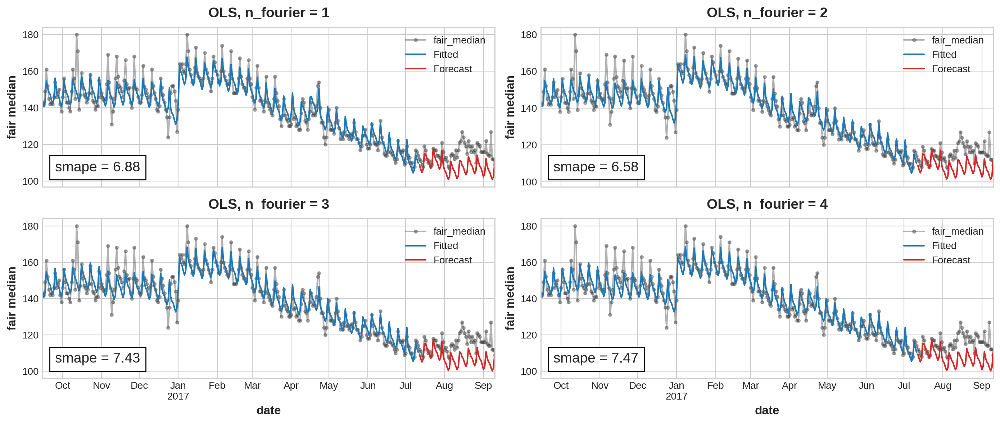

In [843]:
y = temp.fair_median

estimators = [
    ("OLS", LinearRegression()),
    #("Theil-Sen", TheilSenRegressor(random_state=42)),
    #("RANSAC", RANSACRegressor(random_state=42)),
    #("HuberRegressor", HuberRegressor(epsilon=1)),
]
  
nfour = 4
ncols = 2
nrows = math.ceil(nfour/ncols)

fig, axs = plt.subplots(nrows=nrows, ncols = ncols, sharex=True, sharey=False, figsize=(ncols*7,nrows*3))

smape_OLS_v2 = model_eval_v2(LinearRegression(), 'OLS', nfour, y, stat_list=['median'])

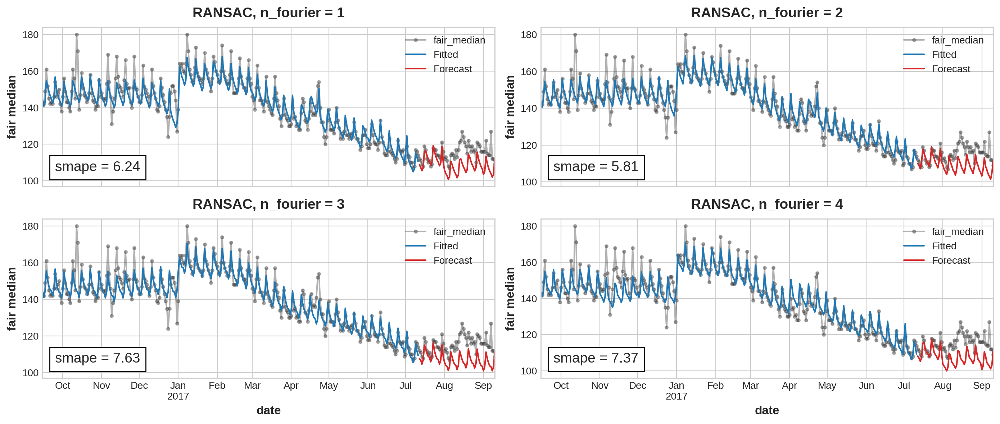

In [840]:
y = temp.fair_median

estimators = [
    ("OLS", LinearRegression()),
    #("Theil-Sen", TheilSenRegressor(random_state=42)),
    #("RANSAC", RANSACRegressor(random_state=42)),
    #("HuberRegressor", HuberRegressor(epsilon=1)),
]
  
nfour = 4
ncols = 2
nrows = math.ceil(nfour/ncols)

fig, axs = plt.subplots(nrows=nrows, ncols = ncols, sharex=True, sharey=False, figsize=(ncols*7,nrows*3))

smape_RANSAC_v2 = model_eval_v2(RANSACRegressor(random_state=42), 'RANSAC', nfour, y, stat_list=['median'])

# 5. Two-stage hybrid model <a class="anchor" id="h5"></a>

An attempt to improve forecast results by training the XGBoost regressor on the residuals of linear models.

In [783]:
class HybridModel:
    def __init__(self, model1, model2):
        self.model1 = model1
        self.model2 = model2 
       
    def fit(self, X1, X2, y):
        
        self.model1.fit(X1,y)
        y_pred1 = pd.Series(self.model1.predict(X1), index = X1.index)   

        y_resid = y - y_pred1
        #y_resid = y_resid.stack().squeeze() # wide to long
    
        self.model2.fit(X2, y_resid)       
 
        self.y_pred1 = y_pred1
        self.y_resid = y_resid
    
    def predict(self, X1, X2):
    
        y_pred = pd.Series(self.model1.predict(X1),index=X1.index)        
        y_pred += self.model2.predict(X2)

        return y_pred        
        

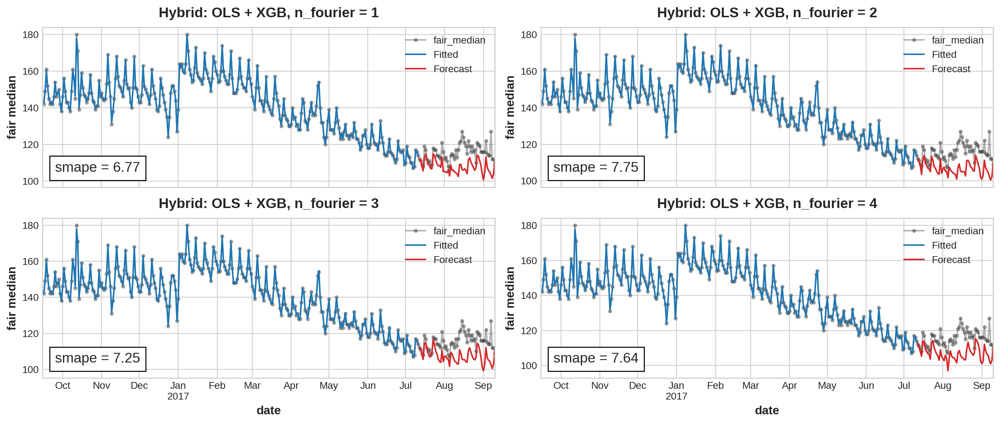

In [835]:
y = temp.fair_median

smape_results_hybrid = {}

train_ind, test_ind = train_test_split(temp.index, test_size=n_test_days, shuffle=False)

y_train = y[train_ind]
y_valid = y[test_ind]

model = HybridModel(LinearRegression(fit_intercept=False), XGBRegressor())
model_name = 'Hybrid: OLS + XGB'

nfour = 4
ncols = 2
nrows = math.ceil(nfour/ncols)

fig, axs = plt.subplots(nrows=nrows, ncols = ncols, sharex=True, sharey=False, figsize=(ncols*7,nrows*3))

for ax, n_fourier in zip(fig.get_axes(), range(1,nfour+1)):
    
    fourier = CalendarFourier('A',n_fourier)
#four = Fourier(period=365.25, order=2)

    dp = DeterministicProcess(
        index = temp.index,
        constant=True,
        order = 2, 
        seasonal=True,
        #drop=True,
        additional_terms=[fourier]
    )
    
    X1 = dp.in_sample()   
    X2 = temp.drop(['fair_median'],axis=1)
    #X2 = pd.concat([X2, temp.index.quarter.to_series(index=temp.index, name='quarter')], axis=1)
       
    #y_weekday = y_train.groupby(y_train.index.weekday).agg(['sum','mean','median']).apply(normalization)
    #y_nweek = y_train.groupby(y_train.index.dayofyear // 7).agg(['sum','mean','median']).apply(normalization)
    #y_month = y_train.groupby(y_train.index.month).agg(['sum','mean','median']).apply(normalization)
    #y_quater = y_train.groupby(y_train.index.dayofyear // 92).agg(stat_list).apply(normalization)
    
    #y_quarter_month_corr = normalization(y_train.groupby(y_train.index.quarter).apply(lambda x: autocorr(x,30)))
    #y_quarter_week_corr = normalization(y_train.groupby(y_train.index.quarter).apply(lambda x: autocorr(x,7)))
    
    #y_quarter_month_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.quarter]).apply(lambda x: autocorr(x,30))).groupby(level=1).mean()
    #y_quarter_week_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.quarter]).apply(lambda x: autocorr(x,7))).groupby(level=1).mean()
    
    #y_quarter_month_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.quarter]).apply(lambda x: x.corr(x.shift(30)))).groupby(level=1).mean()
    #y_quarter_month_corr = normalization(y_train.groupby(y_train.index.quarter).apply(lambda x: x.corr(x.shift(30))))
    #y_quarter_week_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.quarter]).apply(lambda x: x.corr(x.shift(7)))).groupby(level=1).mean()
        
    y_month_week_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.month]).apply(lambda x: x.corr(x.shift(7)))).groupby(level=1).mean()         
    y_week_2day_corr = normalization(y_train.groupby(y_train.index.weekofyear).apply(lambda x: x.corr(x.shift(2))))    
    
    for period in ['weekofyear','month','weekday']:        
        X1 = X1.join(add_period_stat(y_train, period, stat_list), on=getattr(X1.index, period), rsuffix=f'_{period}')        
     
        #X = X.join(y_quater, on='quater', rsuffix='_quater')
        #X = X.join(y_quarter_month_corr, on=X.index.quarter, rsuffix='_monthcorr')
        #X = X.join(y_quarter_week_corr, on=X.index.quarter,rsuffix='_weekcorr')
    
    X1 = X1.join(y_month_week_corr, on=X1.index.month,rsuffix='_monthweekcorr')     
    X1 = X1.join(y_week_2day_corr, on=X1.index.weekofyear,rsuffix='_2daycorr')    
        
    # Lalel encoding of object columns
    for col in X2.select_dtypes('object'):
        X2[col] = X2[col].astype('category').cat.codes               
    
    X1_train = X1.loc[train_ind,:]    
    X1_valid = X1.loc[test_ind,:]
    
    X2_train = X2.loc[train_ind,:]    
    X2_valid = X2.loc[test_ind,:]
    
                          
    model.fit(X1_train,X2_train,np.log1p(y_train))
    
    y_fit = np.expm1(pd.Series(model.predict(X1_train,X2_train),index=train_ind))
    y_pred = np.expm1(pd.Series(model.predict(X1_valid,X2_valid),index=test_ind))
    
    
    smape_value = smape(y_pred, y_valid)       
    
    smape_results_hybrid[n_fourier] = smape_value
    
    predplot_kwargs = {'ylabel':'fair median', 'title': f'{model_name}, n_fourier = {n_fourier}'}
    
    prediction_plot(y[-(300+n_test_days):], y_fit[-300:], y_pred, ax=ax, smape_val= smape_value, **predplot_kwargs)
    

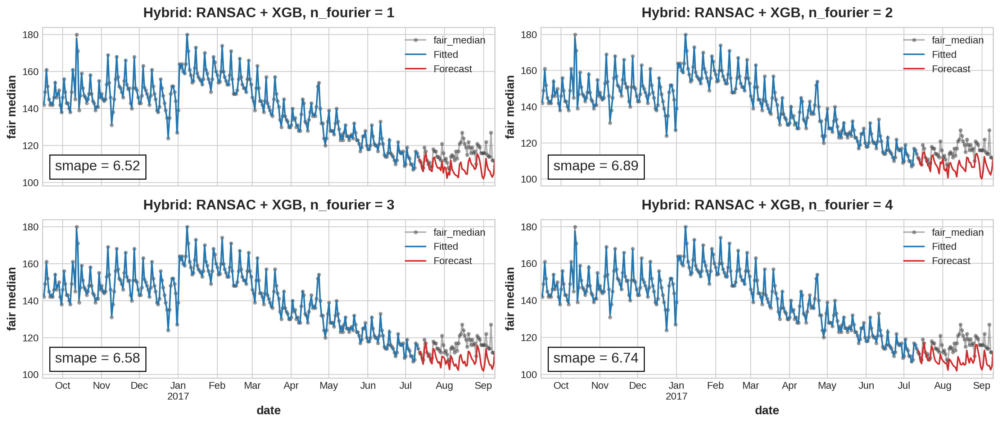

In [841]:
y = temp.fair_median

smape_results_hybrid = {}

train_ind, test_ind = train_test_split(temp.index, test_size=n_test_days, shuffle=False)

y_train = y[train_ind]
y_valid = y[test_ind]

model = HybridModel(RANSACRegressor(random_state=42), XGBRegressor())
model_name = 'Hybrid: RANSAC + XGB'

nfour = 4
ncols = 2
nrows = math.ceil(nfour/ncols)

fig, axs = plt.subplots(nrows=nrows, ncols = ncols, sharex=True, sharey=False, figsize=(ncols*7,nrows*3))

for ax, n_fourier in zip(fig.get_axes(), range(1,nfour+1)):
    
    fourier = CalendarFourier('A',n_fourier)
#four = Fourier(period=365.25, order=2)

    dp = DeterministicProcess(
        index = temp.index,
        constant=True,
        order = 2, 
        seasonal=True,
        #drop=True,
        additional_terms=[fourier]
    )
    
    X1 = dp.in_sample()   
    X2 = temp.drop(['fair_median'],axis=1)
    #X2 = pd.concat([X2, temp.index.quarter.to_series(index=temp.index, name='quarter')], axis=1)
       
    #y_weekday = y_train.groupby(y_train.index.weekday).agg(['sum','mean','median']).apply(normalization)
    #y_nweek = y_train.groupby(y_train.index.dayofyear // 7).agg(['sum','mean','median']).apply(normalization)
    #y_month = y_train.groupby(y_train.index.month).agg(['sum','mean','median']).apply(normalization)
    #y_quater = y_train.groupby(y_train.index.dayofyear // 92).agg(stat_list).apply(normalization)
    
    #y_quarter_month_corr = normalization(y_train.groupby(y_train.index.quarter).apply(lambda x: autocorr(x,30)))
    #y_quarter_week_corr = normalization(y_train.groupby(y_train.index.quarter).apply(lambda x: autocorr(x,7)))
    
    #y_quarter_month_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.quarter]).apply(lambda x: autocorr(x,30))).groupby(level=1).mean()
    #y_quarter_week_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.quarter]).apply(lambda x: autocorr(x,7))).groupby(level=1).mean()
    
    #y_quarter_month_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.quarter]).apply(lambda x: x.corr(x.shift(30)))).groupby(level=1).mean()
    #y_quarter_month_corr = normalization(y_train.groupby(y_train.index.quarter).apply(lambda x: x.corr(x.shift(30))))
    #y_quarter_week_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.quarter]).apply(lambda x: x.corr(x.shift(7)))).groupby(level=1).mean()
        
    y_month_week_corr = normalization(y_train.groupby([y_train.index.year, y_train.index.month]).apply(lambda x: x.corr(x.shift(7)))).groupby(level=1).mean()         
    y_week_2day_corr = normalization(y_train.groupby(y_train.index.weekofyear).apply(lambda x: x.corr(x.shift(2))))    
    
    for period in ['weekofyear','month','weekday']:        
        X1 = X1.join(add_period_stat(y_train, period, stat_list), on=getattr(X1.index, period), rsuffix=f'_{period}')        
     
        #X = X.join(y_quater, on='quater', rsuffix='_quater')
        #X = X.join(y_quarter_month_corr, on=X.index.quarter, rsuffix='_monthcorr')
        #X = X.join(y_quarter_week_corr, on=X.index.quarter,rsuffix='_weekcorr')
    
    X1 = X1.join(y_month_week_corr, on=X1.index.month,rsuffix='_monthweekcorr')     
    X1 = X1.join(y_week_2day_corr, on=X1.index.weekofyear,rsuffix='_2daycorr')    
        
    # Lalel encoding of object columns
    for col in X2.select_dtypes('object'):
        X2[col] = X2[col].astype('category').cat.codes               
    
    X1_train = X1.loc[train_ind,:]    
    X1_valid = X1.loc[test_ind,:]
    
    X2_train = X2.loc[train_ind,:]    
    X2_valid = X2.loc[test_ind,:]
    
                          
    model.fit(X1_train,X2_train,np.log1p(y_train))
    
    y_fit = np.expm1(pd.Series(model.predict(X1_train,X2_train),index=train_ind))
    y_pred = np.expm1(pd.Series(model.predict(X1_valid,X2_valid),index=test_ind))
    
    
    smape_value = smape(y_pred, y_valid)       
    
    smape_results_hybrid[n_fourier] = smape_value
    
    predplot_kwargs = {'ylabel':'fair median', 'title': f'{model_name}, n_fourier = {n_fourier}'}
    
    prediction_plot(y[-(300+n_test_days):], y_fit[-300:], y_pred, ax=ax, smape_val= smape_value, **predplot_kwargs)
    